<a href="https://colab.research.google.com/github/guptaa98/text_mercato_assignment/blob/main/Predict%20Neckline%2C%20Material%20and%20Pattern%20of%20Image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive 

drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [2]:
#import all the necessary packages.
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import warnings
from nltk.tokenize import word_tokenize
import nltk
import math
import time
import re
import os
import seaborn as sns
from collections import Counter
import plotly
from tqdm import tqdm
import cv2

plotly.offline.init_notebook_mode(connected=True)
warnings.filterwarnings("ignore")

In [3]:
data = pd.read_excel('/content/drive/My Drive/dataset.xlsx')
data.head()

,Title,Description,Material,Pattern,Neckline,Image_Path
0,Peach Poly Crepe jumpsuit,This stylish foil print kurta from janasya is ...,Crepe,Printed,Round Neck,/images/pic_0.jpg
1,Light Brown Bias Yoke Checks Top,This check pattern top by Work Label is crafte...,Cotton,Checks,Round Neck,/images/pic_1.jpg
2,Off White Geometric Straight Cotton Dobby Top ...,"Featuring elegant printed details, this off wh...",Viscose,Checks,Round Neck,/images/pic_2.jpg
3,Blue Me Away Cape Top,Add an extra dose of style to your casual ward...,Polyester,Solid/Plain,V-Neck,/images/pic_3.jpg
4,Yellow On A High Gown,Yellow polyester georgette maxi dress. Polyest...,Polyester,Solid/Plain,V-Neck,/images/pic_4.jpg


In [4]:
path = list(data['Image_Path'])

In [22]:
imgpath = []
for i in path:
  p = '/content/drive/My Drive' + i
  imgpath.append(p)
data['Image_Path'] = imgpath

In [6]:
Neckline = set ()
for i in data['Neckline']:
  Neckline.add(i)
NL = list (Neckline)

In [7]:
Pattern = set ()
for i in data['Pattern']:
  Pattern.add(i)
PT = list (Pattern)

In [8]:
Material = set ()
for i in data['Material']:
  Material.add(i)
MT = list (Material)

(224, 224, 3)


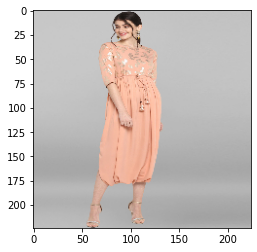

In [9]:
import cv2
img = cv2.imread('/content/drive/My Drive/images/pic_0.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = cv2.resize(img, (224,224))
print(img.shape)
plt.imshow(img)

In [10]:
print(data['Neckline'].describe())

count        500
unique        22
top       V-Neck
freq         113
Name: Neckline, dtype: object


In [11]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
data['Neckline'] = le.fit_transform(data['Neckline'])

In [12]:
print(data['Material'].describe())

count           500
unique           30
top       Polyester
freq            147
Name: Material, dtype: object


In [13]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
data['Material'] = le.fit_transform(data['Material'])

In [14]:
print(data['Pattern'].describe())

count             500
unique             18
top       Solid/Plain
freq              204
Name: Pattern, dtype: object


In [15]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
data['Pattern'] = le.fit_transform(data['Pattern'])

In [23]:
data.head()

,Title,Description,Image_Path
0,Peach Poly Crepe jumpsuit,This stylish foil print kurta from janasya is ...,/content/drive/My Drive/images/pic_0.jpg
1,Light Brown Bias Yoke Checks Top,This check pattern top by Work Label is crafte...,/content/drive/My Drive/images/pic_1.jpg
2,Off White Geometric Straight Cotton Dobby Top ...,"Featuring elegant printed details, this off wh...",/content/drive/My Drive/images/pic_2.jpg
3,Blue Me Away Cape Top,Add an extra dose of style to your casual ward...,/content/drive/My Drive/images/pic_3.jpg
4,Yellow On A High Gown,Yellow polyester georgette maxi dress. Polyest...,/content/drive/My Drive/images/pic_4.jpg


In [17]:
y = np.empty((1,500))
y = data['Neckline']
y_p = np.empty((1,500))
y_p = data['Pattern']
y_m = np.empty((1,500))
y_m = data['Material']

In [18]:
from keras.utils.np_utils import to_categorical

In [19]:
y = to_categorical(y,22)
y_m = to_categorical(y_m,30)
y_p = to_categorical(y_p,18)

In [20]:
data.drop('Neckline',axis=1,inplace=True)
data.drop('Material',axis=1,inplace=True)
data.drop('Pattern',axis=1,inplace=True)

In [24]:
data.head()

,Title,Description,Image_Path
0,Peach Poly Crepe jumpsuit,This stylish foil print kurta from janasya is ...,/content/drive/My Drive/images/pic_0.jpg
1,Light Brown Bias Yoke Checks Top,This check pattern top by Work Label is crafte...,/content/drive/My Drive/images/pic_1.jpg
2,Off White Geometric Straight Cotton Dobby Top ...,"Featuring elegant printed details, this off wh...",/content/drive/My Drive/images/pic_2.jpg
3,Blue Me Away Cape Top,Add an extra dose of style to your casual ward...,/content/drive/My Drive/images/pic_3.jpg
4,Yellow On A High Gown,Yellow polyester georgette maxi dress. Polyest...,/content/drive/My Drive/images/pic_4.jpg


In [25]:
y

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [1., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [26]:
y_m

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [27]:
y_p

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [28]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(data, y, test_size=0.33, random_state=42)
X_train_p, X_test_p, y_train_p, y_test_p = train_test_split(data, y_p, test_size=0.33, random_state=42)
X_train_m, X_test_m, y_train_m, y_test_m = train_test_split(data, y_m, test_size=0.33, random_state=42)

In [54]:
path_train = list(X_train['Image_Path'])
path_test = list(X_test['Image_Path'])

path_train_p = list(X_train_p['Image_Path'])
path_test_p = list(X_test_p['Image_Path'])

path_train_m = list(X_train_m['Image_Path'])
path_test_m = list(X_test_m['Image_Path'])

In [55]:
imgpath_train = []
imgpath_train = X_train['Image_Path']
imgpath_test = []
imgpath_test = X_test['Image_Path']


imgpath_train_p = []
imgpath_train_p = X_train_p['Image_Path']
imgpath_test_p = []
imgpath_test_p = X_test_p['Image_Path']


imgpath_train_m = []
imgpath_train_m = X_train_m['Image_Path']

imgpath_test_m = []
imgpath_test_m = X_test_m['Image_Path']

In [56]:
x_train = []
for i in tqdm(imgpath_train):
  img = cv2.imread(i)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img = cv2.resize(img, (224,224))
  x_train.append(img)


x_train_p = []
for i in tqdm(imgpath_train_p):
  img = cv2.imread(i)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img = cv2.resize(img, (224,224))
  x_train_p.append(img)


x_train_m = []
for i in tqdm(imgpath_train_m):
  img = cv2.imread(i)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img = cv2.resize(img, (224,224))
  x_train_m.append(img)

100%|██████████| 335/335 [00:14<00:00, 22.92it/s]


In [57]:
x_test = []
for i in tqdm(imgpath_test):
  img = cv2.imread(i)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img = cv2.resize(img, (224,224))
  x_test.append(img)


x_test_m = []
for i in tqdm(imgpath_test_m):
  img = cv2.imread(i)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img = cv2.resize(img, (224,224))
  x_test_m.append(img)


x_test_p = []
for i in tqdm(imgpath_test_p):
  img = cv2.imread(i)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img = cv2.resize(img, (224,224))
  x_test_p.append(img)

100%|██████████| 165/165 [00:07<00:00, 23.45it/s]


In [58]:
x_im_train = np.asarray(x_train)

x_im_train_p = np.asarray(x_train_p)

x_im_train_m = np.asarray(x_train_m)

In [59]:
x_im_test = np.asarray(x_test)

x_im_test_p = np.asarray(x_test_p)

x_im_test_m = np.asarray(x_test_m)

In [60]:
print(x_im_train.shape)
print(x_im_test.shape)

print(x_im_train_p.shape)
print(x_im_test_p.shape)

print(x_im_train_m.shape)
print(x_im_test_m.shape)


(335, 224, 224, 3)
(165, 224, 224, 3)
(335, 224, 224, 3)
(165, 224, 224, 3)
(335, 224, 224, 3)
(165, 224, 224, 3)


In [61]:
si = x_im_train[0]

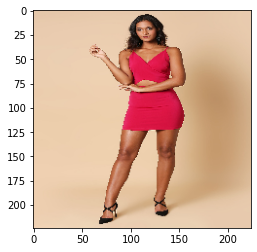

In [62]:
plt.imshow(si)

In [63]:
x_im_train = x_im_train/x_im_train.max()
x_im_test = x_im_test/x_im_test.max()

x_im_train_m = x_im_train/x_im_train_m.max()
x_im_test_m = x_im_test_m/x_im_test_m.max()

x_im_train_p = x_im_train_p/x_im_train_p.max()
x_im_test_p = x_im_test_p/x_im_test_p.max()

In [64]:
import keras
from keras.models import Sequential
from keras.layers import Dense,Flatten,Conv2D, MaxPool2D

In [65]:
model = Sequential()
model.add(Conv2D(filters=32,kernel_size=(4,4),input_shape=(224,224,3),activation='relu'))
model.add(MaxPool2D(pool_size=(2,2)))
model.add(Flatten())
model.add(Dense(128,activation='relu'))
model.add(Dense(22,activation='softmax'))

model.compile(loss='categorical_crossentropy',optimizer='rmsprop',metrics=['accuracy'])

In [66]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 221, 221, 32)      1568      
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 110, 110, 32)      0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 387200)            0         
_________________________________________________________________
dense_4 (Dense)              (None, 128)               49561728  
_________________________________________________________________
dense_5 (Dense)              (None, 22)                2838      
Total params: 49,566,134
Trainable params: 49,566,134
Non-trainable params: 0
_________________________________________________________________


In [67]:
y_train.shape

(335, 22)

In [68]:
x_im_train.shape

(335, 224, 224, 3)

In [69]:
X_train.shape

(335, 3)

In [70]:
model.fit(x_im_train,y_train,epochs=10)

Epoch 1/10
11/11 [==============================] - 15s 1s/step - loss: 106.4656 - accuracy: 0.0665
Epoch 2/10
11/11 [==============================] - 14s 1s/step - loss: 5.3261 - accuracy: 0.1199
Epoch 3/10
11/11 [==============================] - 14s 1s/step - loss: 1.9581 - accuracy: 0.4637
Epoch 4/10
11/11 [==============================] - 14s 1s/step - loss: 0.9741 - accuracy: 0.7453
Epoch 5/10
11/11 [==============================] - 14s 1s/step - loss: 0.4089 - accuracy: 0.9181
Epoch 6/10
11/11 [==============================] - 14s 1s/step - loss: 0.2477 - accuracy: 0.9778
Epoch 7/10
11/11 [==============================] - 14s 1s/step - loss: 0.1511 - accuracy: 0.9671
Epoch 8/10
11/11 [==============================] - 14s 1s/step - loss: 0.0469 - accuracy: 1.0000
Epoch 9/10
11/11 [==============================] - 14s 1s/step - loss: 0.0138 - accuracy: 1.0000
Epoch 10/10
11/11 [==============================] - 14s 1s/step - loss: 0.0049 - accuracy: 1.0000


In [71]:
model.evaluate(x_im_test,y_test)

6/6 [==============================] - 2s 274ms/step - loss: 4.2867 - accuracy: 0.2848


[4.286729335784912, 0.28484848141670227]

In [72]:
classes = model.predict_classes(x_im_test)
print(classes)

[14  9 14 21 21 21 21 14 21 14 21 17  2 21  6 21 21 21 21 14 21 14 21  6
  2  2 17  2  2 21 21 21 14 21  2 21 21 21 21 21 21 14  2 21 21 21 14  2
 21  2  2  2  2 21  0 14 14  2 14 17 14 14 21 21 21 21  2 21 21 21 21 17
  2 21 21 21 21 21  2 17 14  2 14  2 17  0  0 21 21  0 14  9  2  2 17 21
 21 21 21 14  2 17  2 21 14  2 21 17 14 21 21 14  2 21 14 17 21 21 17 17
 21  0 14 17 21 21 21 21 21  2 21 21 14 14 21 21 14 14  2 21  2  2  2 21
 21 21 14 21  2 14 14 21 21 14 14 14 21 17 21 21 14  2 14 14 21]


In [73]:
model_p = Sequential()
model_p.add(Conv2D(filters=32,kernel_size=(4,4),input_shape=(224,224,3),activation='relu'))
model_p.add(MaxPool2D(pool_size=(2,2)))
model_p.add(Flatten())
model_p.add(Dense(128,activation='relu'))
model_p.add(Dense(18,activation='softmax'))

model_p.compile(loss='categorical_crossentropy',optimizer='rmsprop',metrics=['accuracy'])

In [74]:
model_p.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 221, 221, 32)      1568      
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 110, 110, 32)      0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 387200)            0         
_________________________________________________________________
dense_6 (Dense)              (None, 128)               49561728  
_________________________________________________________________
dense_7 (Dense)              (None, 18)                2322      
Total params: 49,565,618
Trainable params: 49,565,618
Non-trainable params: 0
_________________________________________________________________


In [76]:
model_p.fit(x_im_train_p,y_train_p,epochs=10)

Epoch 1/10
11/11 [==============================] - 15s 1s/step - loss: 98.6429 - accuracy: 0.2099
Epoch 2/10
11/11 [==============================] - 14s 1s/step - loss: 3.2092 - accuracy: 0.4065
Epoch 3/10
11/11 [==============================] - 14s 1s/step - loss: 1.4328 - accuracy: 0.6234
Epoch 4/10
11/11 [==============================] - 14s 1s/step - loss: 0.5277 - accuracy: 0.8731
Epoch 5/10
11/11 [==============================] - 14s 1s/step - loss: 0.2223 - accuracy: 0.9721
Epoch 6/10
11/11 [==============================] - 14s 1s/step - loss: 0.5525 - accuracy: 0.8889
Epoch 7/10
11/11 [==============================] - 14s 1s/step - loss: 0.0544 - accuracy: 0.9986
Epoch 8/10
11/11 [==============================] - 14s 1s/step - loss: 0.0152 - accuracy: 1.0000
Epoch 9/10
11/11 [==============================] - 14s 1s/step - loss: 0.0043 - accuracy: 1.0000
Epoch 10/10
11/11 [==============================] - 14s 1s/step - loss: 0.0010 - accuracy: 1.0000


In [77]:
model_p.evaluate(x_im_test_p,y_test_p)

6/6 [==============================] - 2s 257ms/step - loss: 3.4597 - accuracy: 0.4970


[3.4596993923187256, 0.49696969985961914]

In [78]:
classes_p = model_p.predict_classes(x_im_test)
print(classes_p)

[12 15 13 15  5  5  5 15 13 13 15 15 13 13 15 15 15 15 15  5 15 15 15 15
 15 15 15  5 15 15 15  5 15 15 15 15 15 15  5 15 15 15 15 15 15 15 15 13
 15 15  5 15 13 13 15 15 15 15 15 15 16 13  5 15 15 15 15 13 15 15 13 15
 15  5 15 15 15 15 13 15 15 13 15 15 15 15 15 15 13 15 15 13 15 15 15 15
 15 13 15 15 15 13 15 15 13 15 15 15 15 15 15 15 15 15 15 15  5 15 15 15
 13 13 15 15 15  5 15 15 16  5 15 15 15 13 13 15 15 15 15 13 15 15  5 15
 15 15 15  5 15 15 15 16  5 15 15  5 15 13  5 13 15 15 15 13 16]


In [79]:
model_m = Sequential()
model_m.add(Conv2D(filters=32,kernel_size=(4,4),input_shape=(224,224,3),activation='relu'))
model_m.add(MaxPool2D(pool_size=(2,2)))
model_m.add(Flatten())
model_m.add(Dense(128,activation='relu'))
model_m.add(Dense(30,activation='softmax'))

model_m.compile(loss='categorical_crossentropy',optimizer='rmsprop',metrics=['accuracy'])

In [80]:
model_m.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 221, 221, 32)      1568      
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 110, 110, 32)      0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 387200)            0         
_________________________________________________________________
dense_8 (Dense)              (None, 128)               49561728  
_________________________________________________________________
dense_9 (Dense)              (None, 30)                3870      
Total params: 49,567,166
Trainable params: 49,567,166
Non-trainable params: 0
_________________________________________________________________


In [81]:
model_m.fit(x_im_train_m,y_train_m,epochs=10)

Epoch 1/10
11/11 [==============================] - 15s 1s/step - loss: 3.1250 - accuracy: 0.1898
Epoch 2/10
11/11 [==============================] - 14s 1s/step - loss: 2.3434 - accuracy: 0.2263
Epoch 3/10
11/11 [==============================] - 14s 1s/step - loss: 2.3309 - accuracy: 0.3063
Epoch 4/10
11/11 [==============================] - 14s 1s/step - loss: 2.3221 - accuracy: 0.2735
Epoch 5/10
11/11 [==============================] - 14s 1s/step - loss: 2.3059 - accuracy: 0.2896
Epoch 6/10
11/11 [==============================] - 14s 1s/step - loss: 2.3170 - accuracy: 0.3120
Epoch 7/10
11/11 [==============================] - 14s 1s/step - loss: 2.2640 - accuracy: 0.2903
Epoch 8/10
11/11 [==============================] - 14s 1s/step - loss: 2.2739 - accuracy: 0.2833
Epoch 9/10
11/11 [==============================] - 14s 1s/step - loss: 2.2524 - accuracy: 0.3267
Epoch 10/10
11/11 [==============================] - 14s 1s/step - loss: 2.1748 - accuracy: 0.3535


In [82]:
model_m.evaluate(x_im_test_m,y_test_m)

6/6 [==============================] - 2s 258ms/step - loss: 199.5946 - accuracy: 0.3333


[199.59457397460938, 0.3333333432674408]

In [83]:
classes_m = model_m.predict_classes(x_im_test)
print(classes_m)

[20 20  2  2  2 20  2  2  2  2 20 20  2  2  2 20 20  2  2 20 20 20  2 20
  2  2  2  2 20 20  2 20 20  2  2  2 20 20 20  2 20  2  2  2  2 20  2  2
  2  2 20 20  2 20 20  2  2  2  2  2  2  2 20 20  2 20  2  2  2  2  2  2
  2  2  2  2 20 20  2  2  2  2 20 20  2 20 20 20  2 20 20  2 20  2  2 20
  2  2  2  2  2 20  2  2  2  2 20  2 20  2  2  2 20  2 20  2  2 20  2  2
  2  2  2 20  2  2  2  2  2  2 20 20 20  2  2 20  2  2  2  2  2  2  2  2
  2  2 20  2  2 20  2  2 20  2  2  2 20  2  2  2  2 20 20  2  2]


In [85]:
print(classes.shape)

(165,)


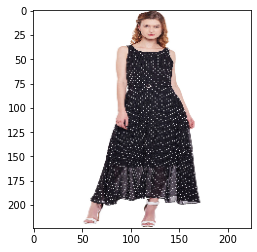

Sweetheart


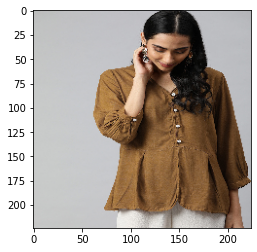

Queen Anne


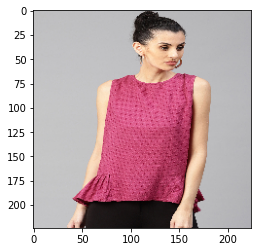

Sweetheart


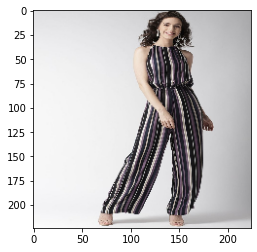

Shoulder Straps


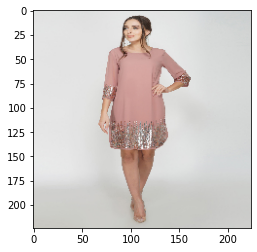

Shoulder Straps


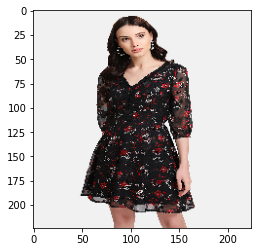

Shoulder Straps


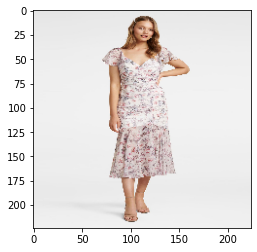

Shoulder Straps


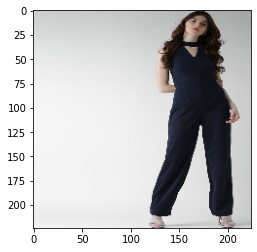

Sweetheart


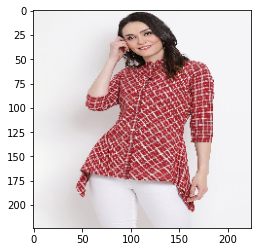

Shoulder Straps


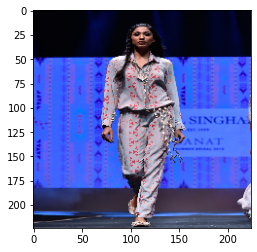

Sweetheart


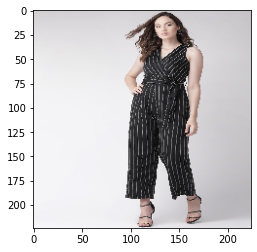

Shoulder Straps


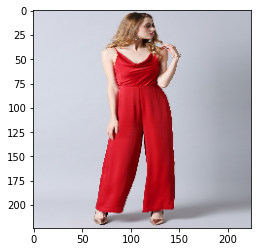

Boat Neck


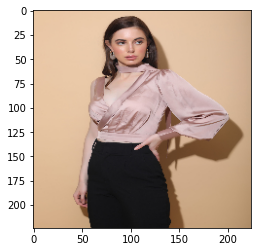

Plunging Neck


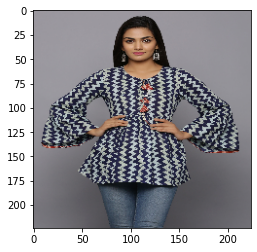

Shoulder Straps


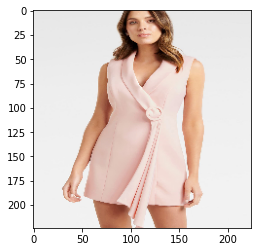

Collar Neck


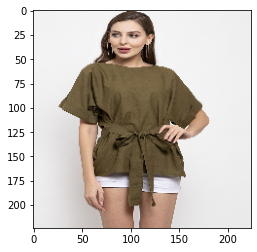

Shoulder Straps


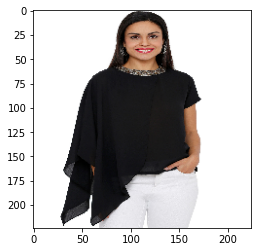

Shoulder Straps


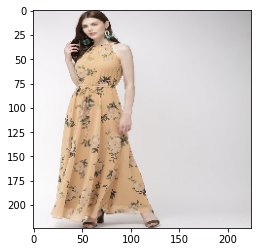

Shoulder Straps


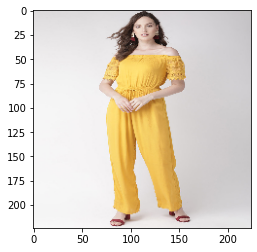

Shoulder Straps


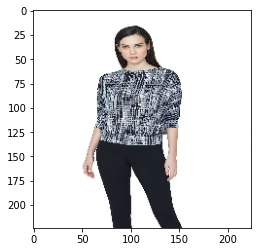

Sweetheart


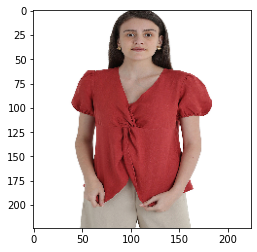

Shoulder Straps


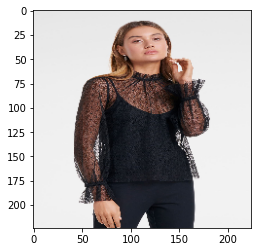

Sweetheart


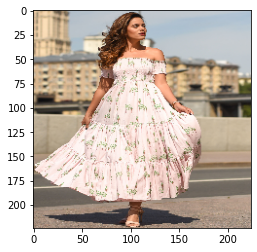

Shoulder Straps


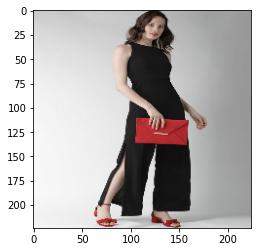

Collar Neck


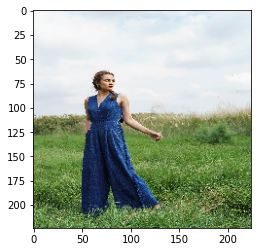

Plunging Neck


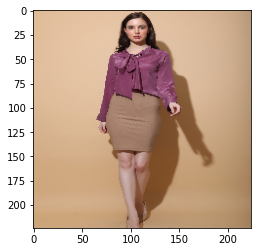

Plunging Neck


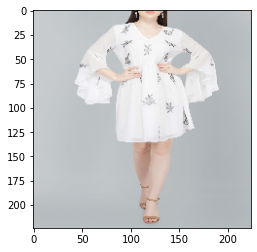

Boat Neck


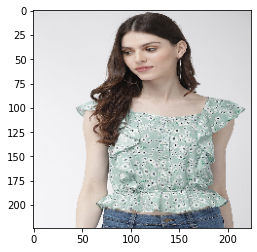

Plunging Neck


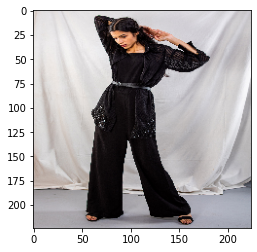

Plunging Neck


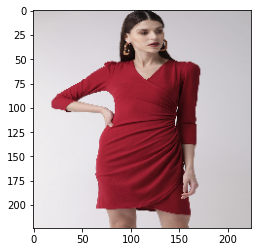

Shoulder Straps


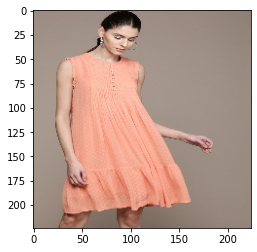

Shoulder Straps


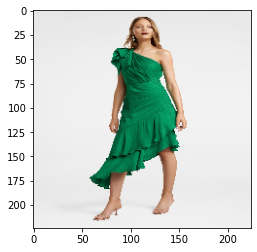

Shoulder Straps


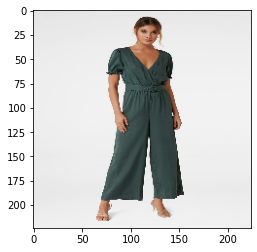

Sweetheart


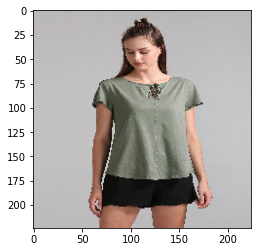

Shoulder Straps


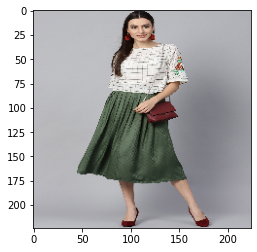

Plunging Neck


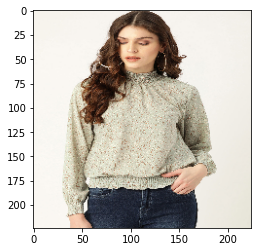

Shoulder Straps


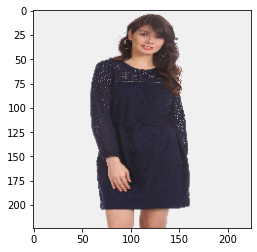

Shoulder Straps


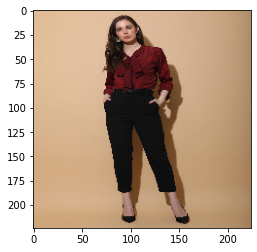

Shoulder Straps


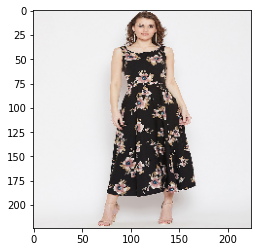

Shoulder Straps


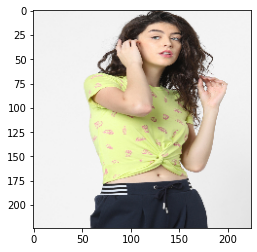

Shoulder Straps


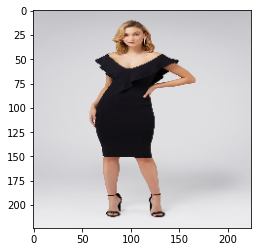

Shoulder Straps


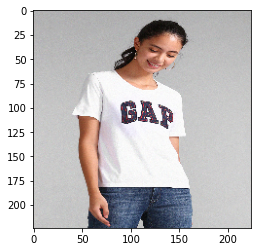

Sweetheart


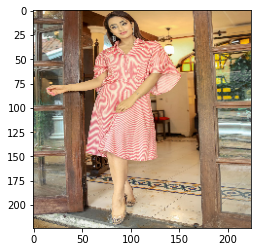

Plunging Neck


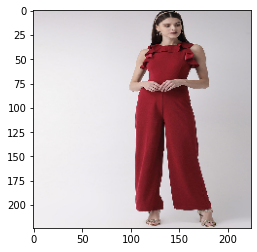

Shoulder Straps


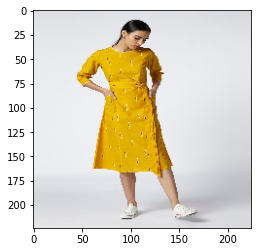

Shoulder Straps


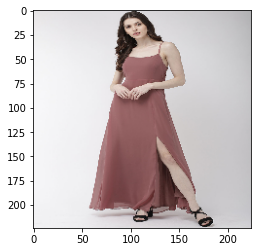

Shoulder Straps


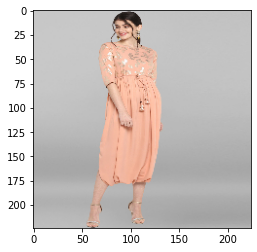

Sweetheart


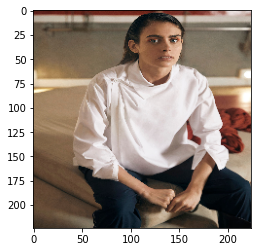

Plunging Neck


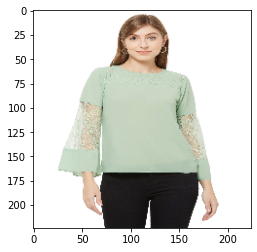

Shoulder Straps


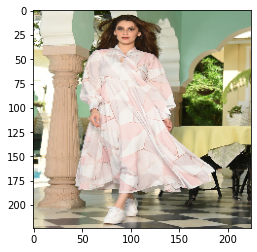

Plunging Neck


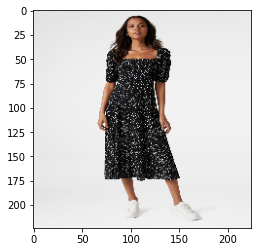

Plunging Neck


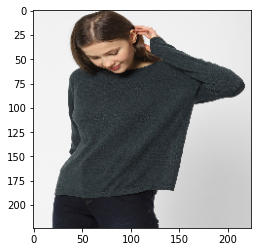

Plunging Neck


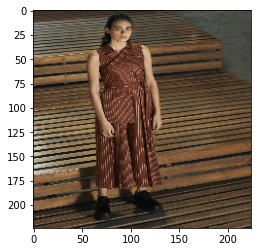

Plunging Neck


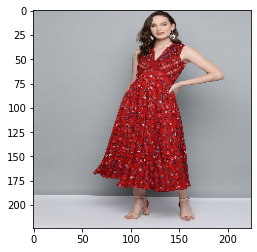

Shoulder Straps


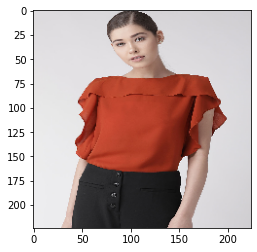

Cowl Neck


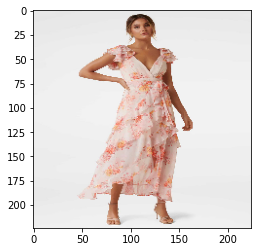

Sweetheart


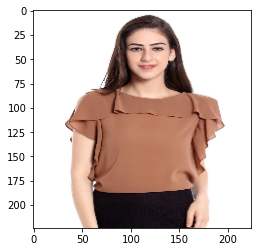

Sweetheart


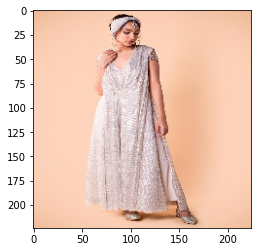

Plunging Neck


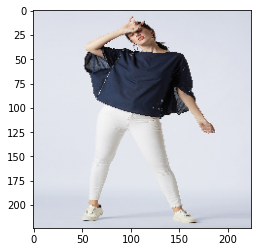

Sweetheart


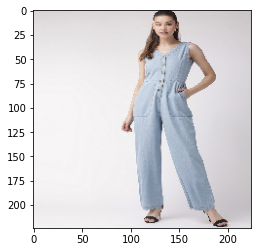

Boat Neck


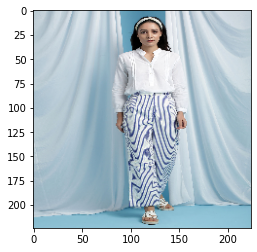

Sweetheart


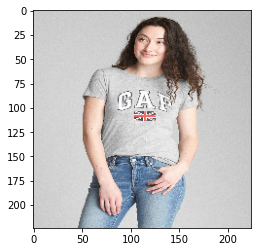

Sweetheart


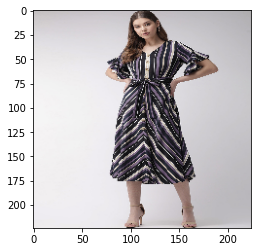

Shoulder Straps


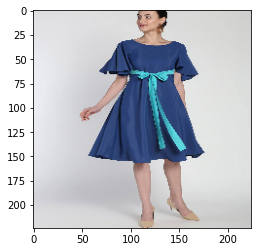

Shoulder Straps


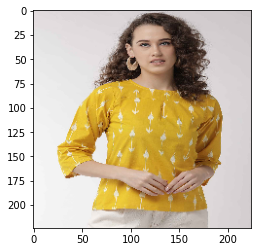

Shoulder Straps


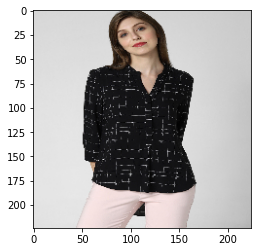

Shoulder Straps


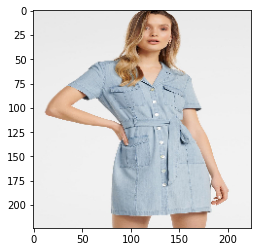

Plunging Neck


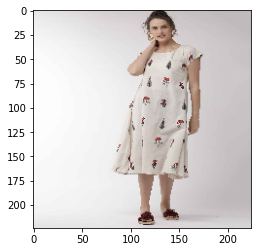

Shoulder Straps


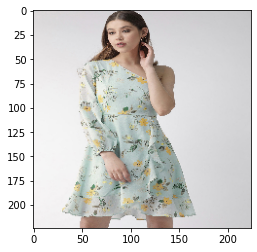

Shoulder Straps


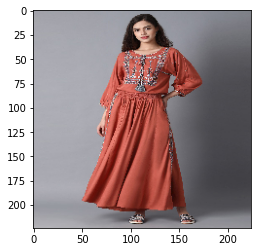

Shoulder Straps


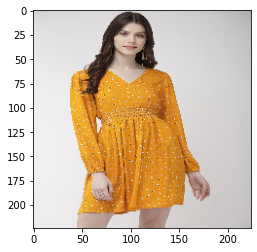

Shoulder Straps


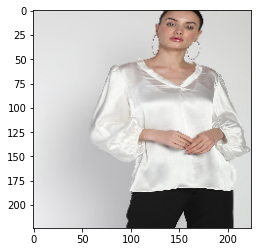

Boat Neck


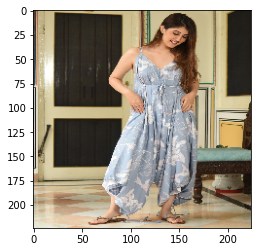

Plunging Neck


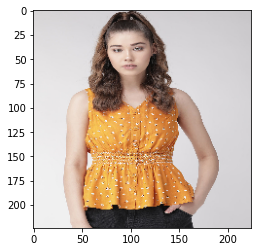

Shoulder Straps


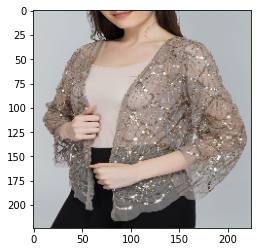

Shoulder Straps


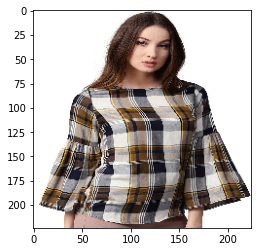

Shoulder Straps


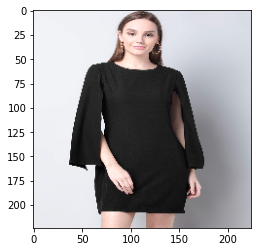

Shoulder Straps


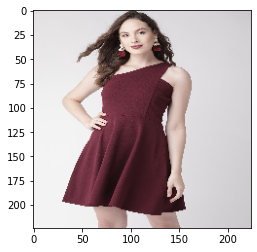

Shoulder Straps


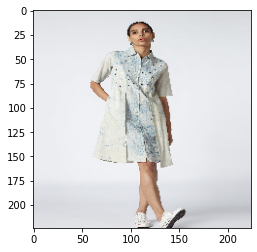

Plunging Neck


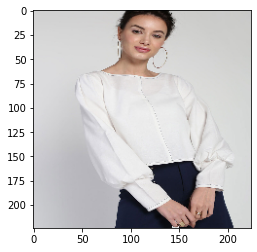

Boat Neck


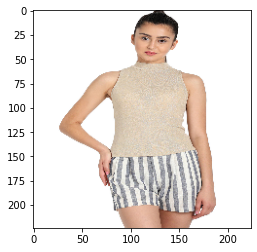

Sweetheart


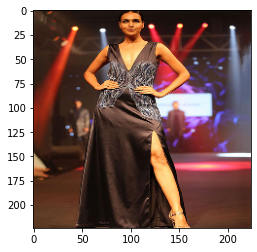

Plunging Neck


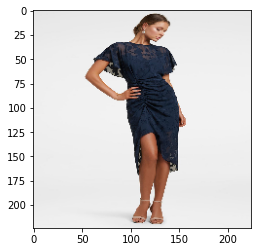

Sweetheart


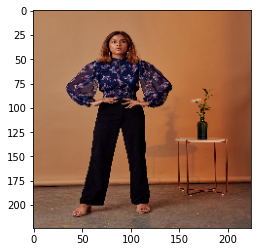

Plunging Neck


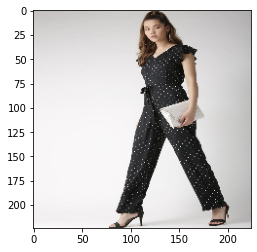

Boat Neck


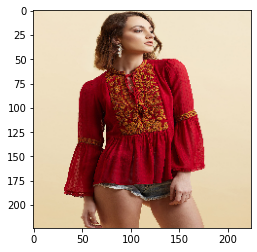

Cowl Neck


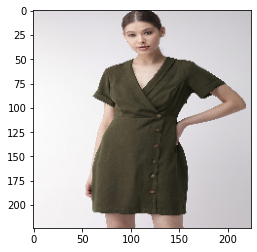

Cowl Neck


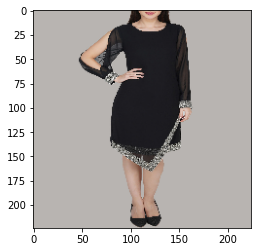

Shoulder Straps


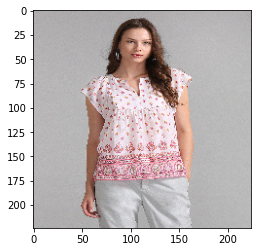

Shoulder Straps


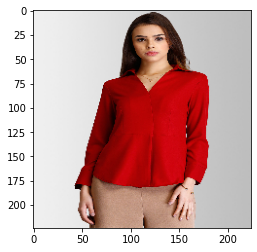

Cowl Neck


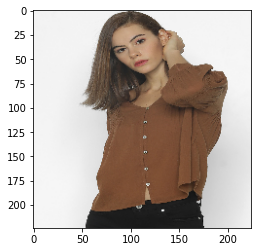

Sweetheart


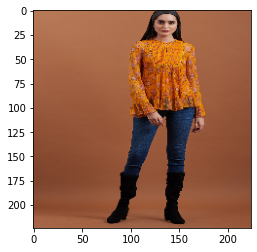

Queen Anne


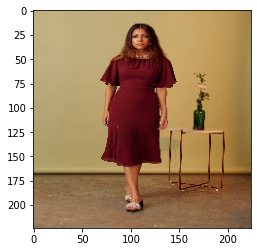

Plunging Neck


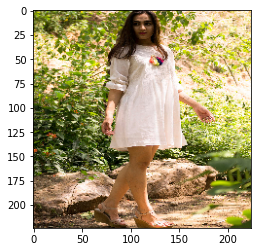

Plunging Neck


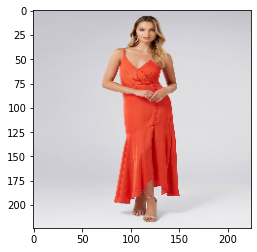

Boat Neck


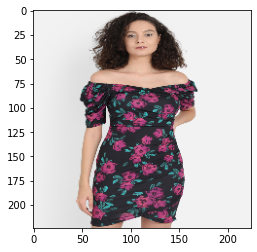

Shoulder Straps


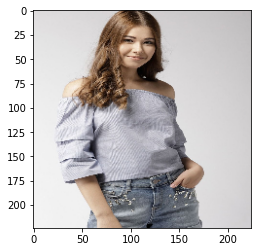

Shoulder Straps


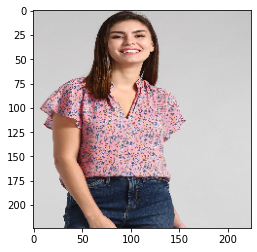

Shoulder Straps


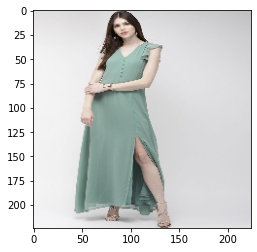

Shoulder Straps


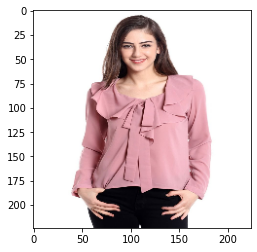

Sweetheart


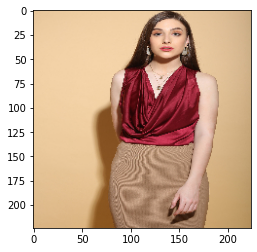

Plunging Neck


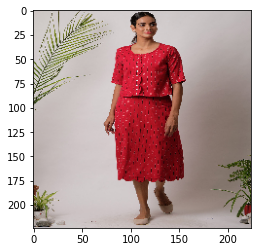

Boat Neck


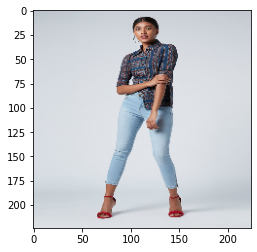

Plunging Neck


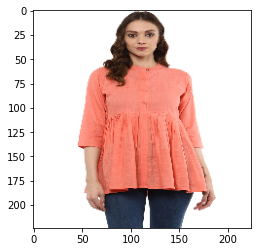

Shoulder Straps


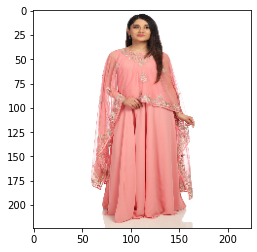

Sweetheart


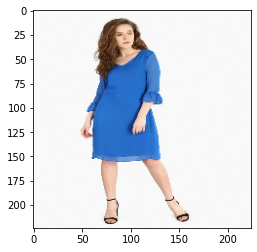

Plunging Neck


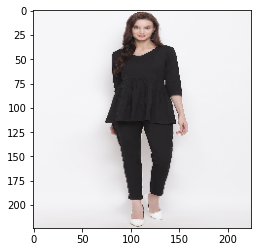

Shoulder Straps


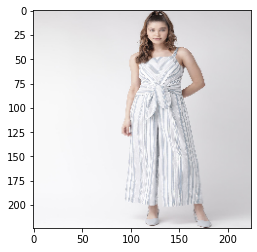

Boat Neck


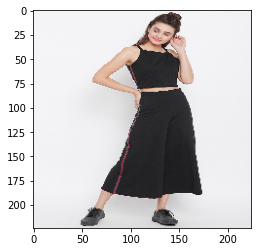

Sweetheart


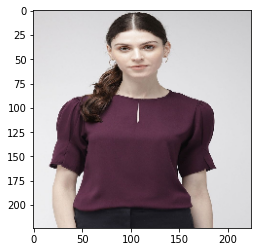

Shoulder Straps


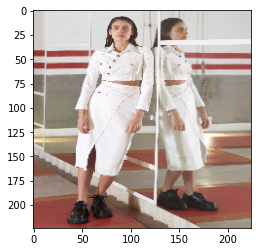

Shoulder Straps


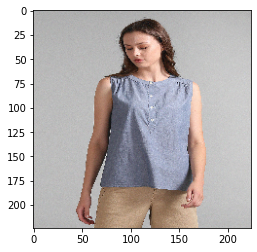

Sweetheart


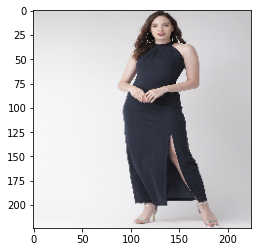

Plunging Neck


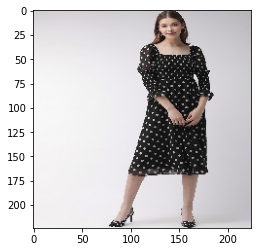

Shoulder Straps


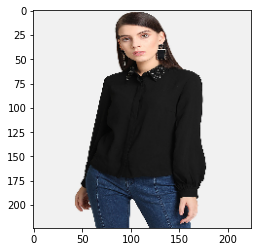

Sweetheart


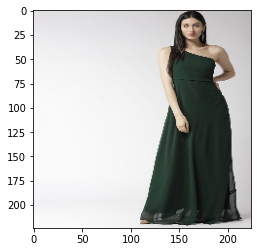

Boat Neck


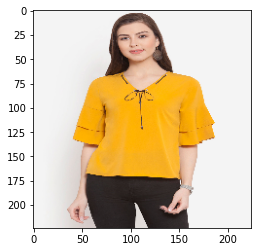

Shoulder Straps


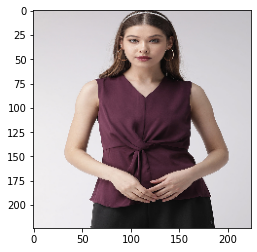

Shoulder Straps


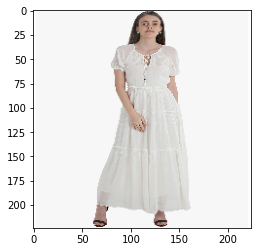

Boat Neck


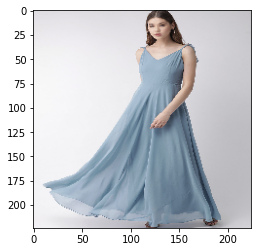

Boat Neck


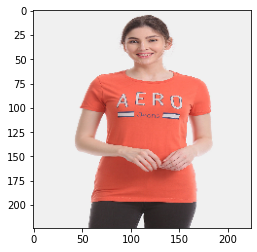

Shoulder Straps


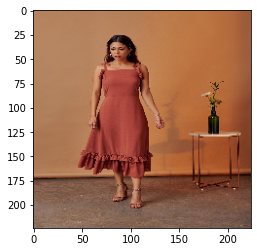

Cowl Neck


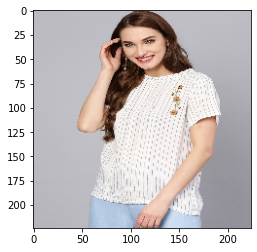

Sweetheart


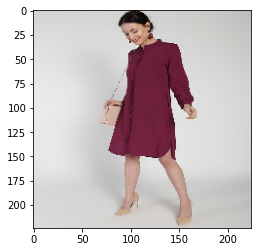

Boat Neck


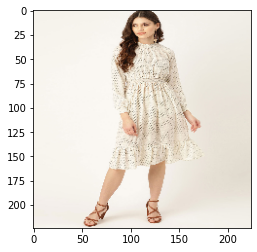

Shoulder Straps


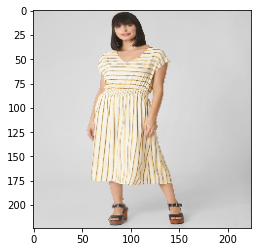

Shoulder Straps


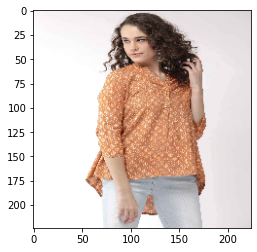

Shoulder Straps


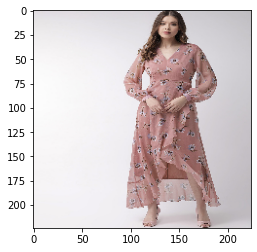

Shoulder Straps


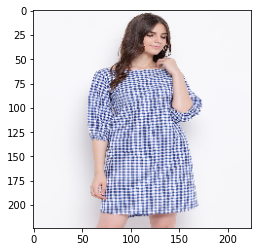

Shoulder Straps


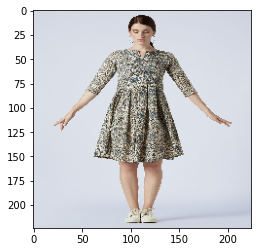

Plunging Neck


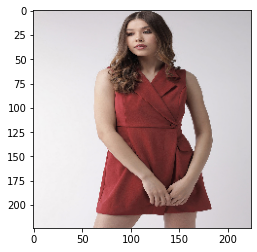

Shoulder Straps


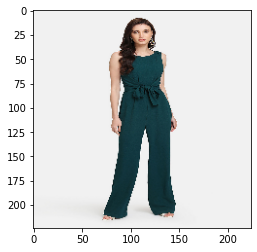

Shoulder Straps


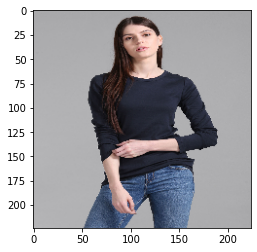

Sweetheart


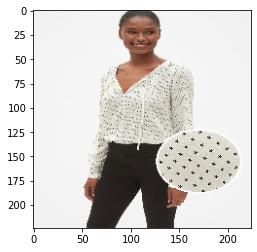

Sweetheart


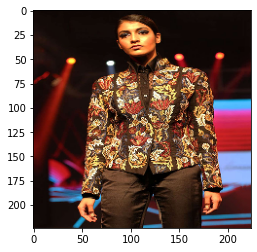

Shoulder Straps


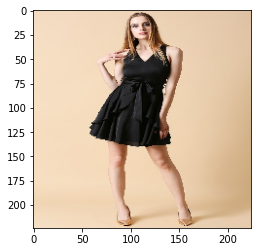

Shoulder Straps


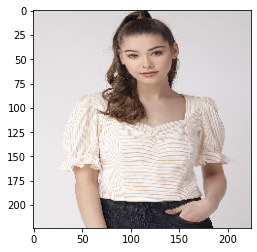

Sweetheart


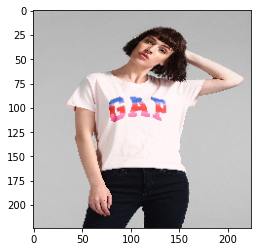

Sweetheart


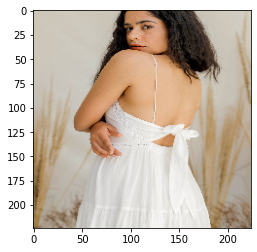

Plunging Neck


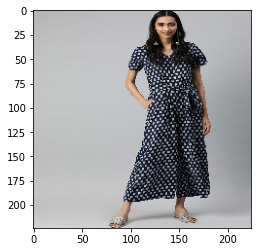

Shoulder Straps


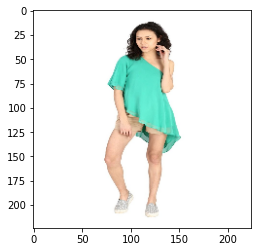

Plunging Neck


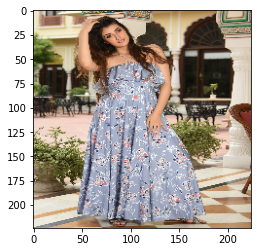

Plunging Neck


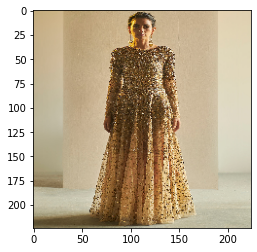

Plunging Neck


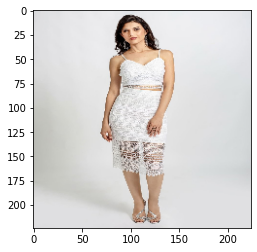

Shoulder Straps


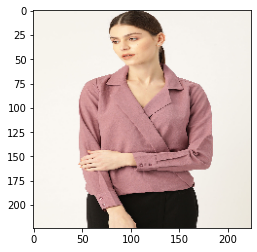

Shoulder Straps


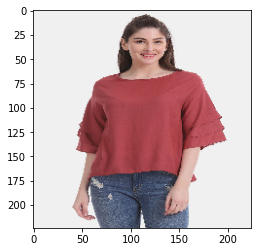

Shoulder Straps


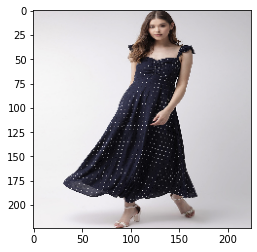

Sweetheart


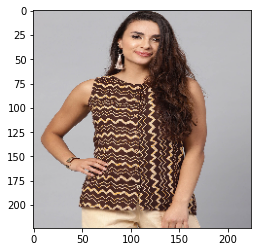

Shoulder Straps


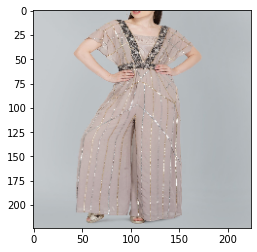

Plunging Neck


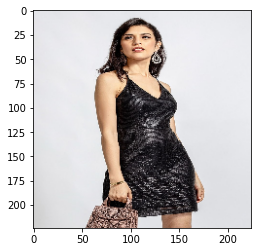

Sweetheart


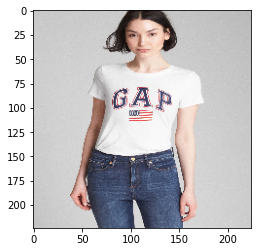

Sweetheart


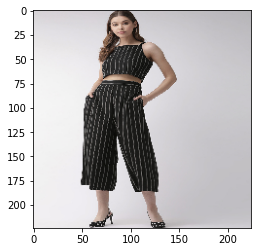

Shoulder Straps


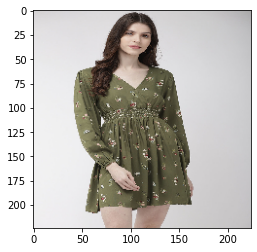

Shoulder Straps


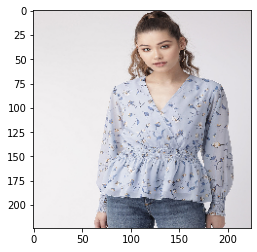

Sweetheart


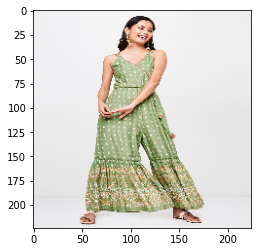

Sweetheart


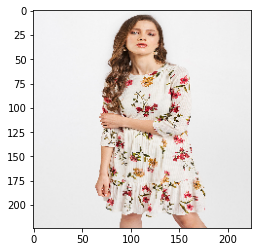

Sweetheart


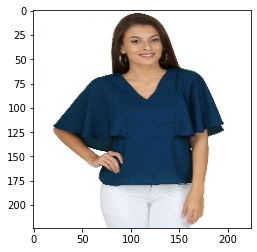

Shoulder Straps


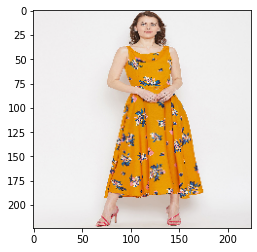

Boat Neck


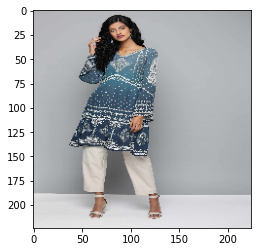

Shoulder Straps


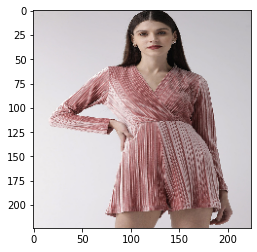

Shoulder Straps


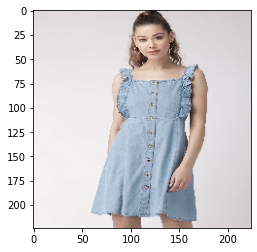

Sweetheart


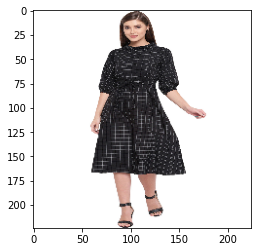

Plunging Neck


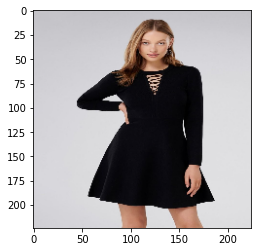

Sweetheart


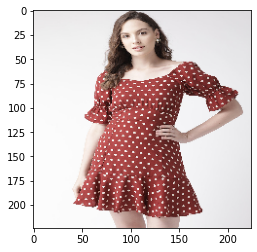

Sweetheart


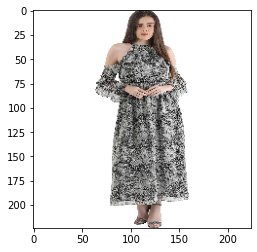

Shoulder Straps


In [86]:
#Neckline
from keras.models import load_model
model.compile(loss='categorical_crossentropy',
              optimizer='rmsprop',
              metrics=['accuracy'])

ind = 0
for i in (X_test['Image_Path']):
  img = cv2.imread(i)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 
  img = cv2.resize(img, (224,224))
  plt.imshow(img)
  plt.show()
  if(ind < 165):
    print(NL[classes[ind]])
    ind = ind + 1 

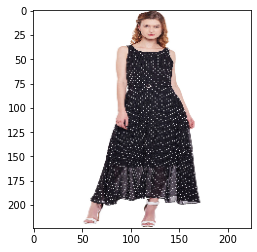

Stripes


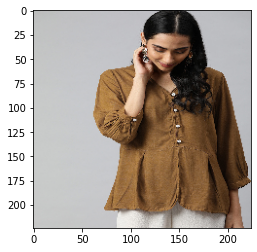

Printed


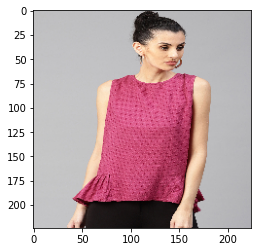

Ombre


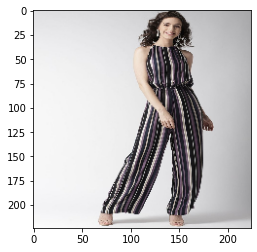

Printed


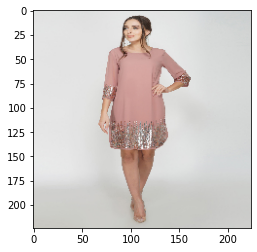

Animal Print


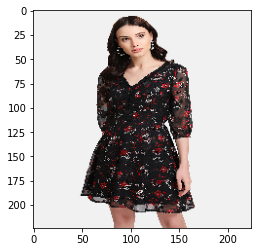

Animal Print


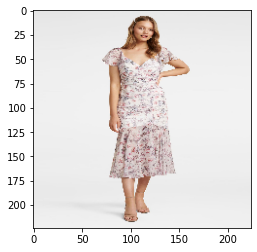

Animal Print


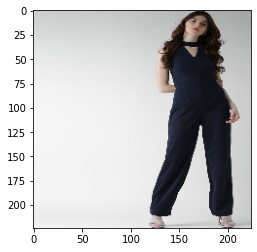

Printed


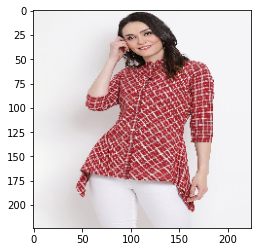

Ombre


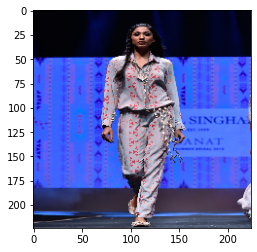

Ombre


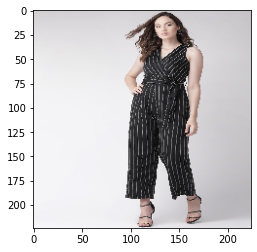

Printed


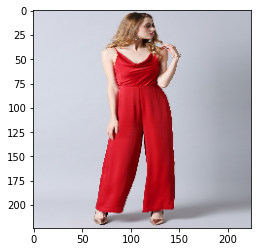

Printed


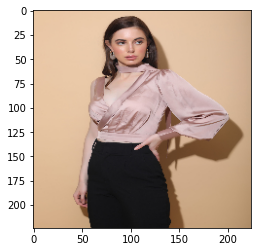

Ombre


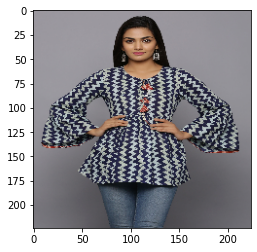

Ombre


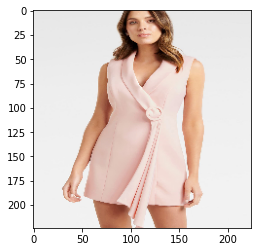

Printed


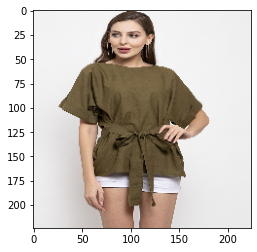

Printed


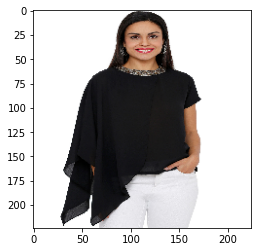

Printed


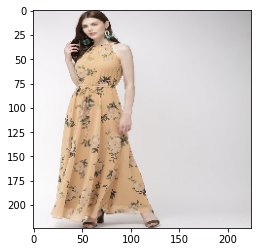

Printed


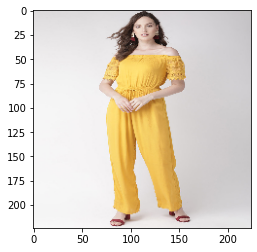

Printed


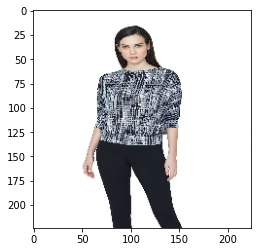

Animal Print


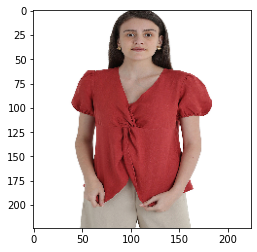

Printed


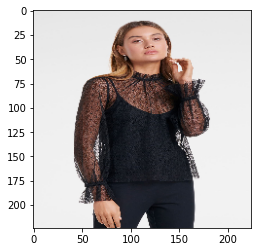

Printed


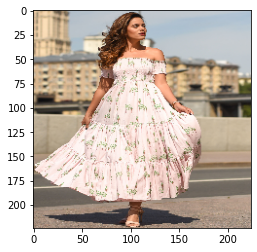

Printed


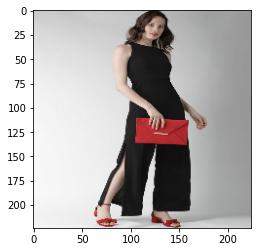

Printed


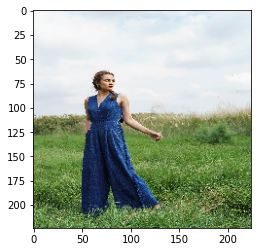

Printed


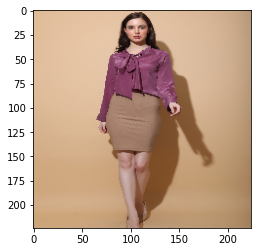

Printed


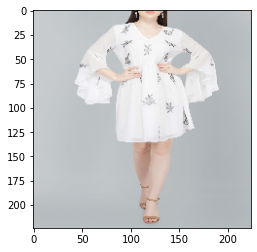

Printed


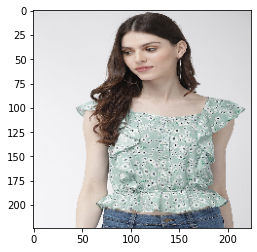

Animal Print


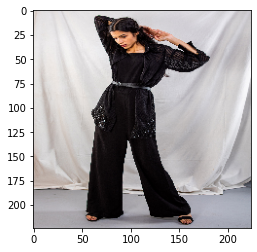

Printed


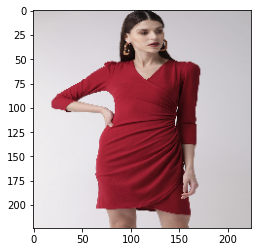

Printed


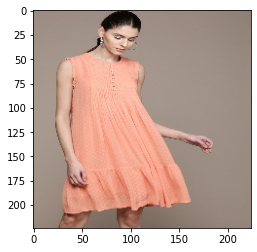

Printed


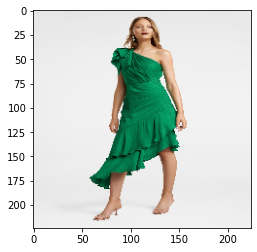

Animal Print


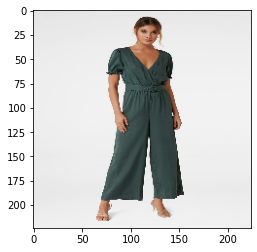

Printed


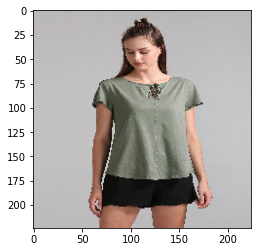

Printed


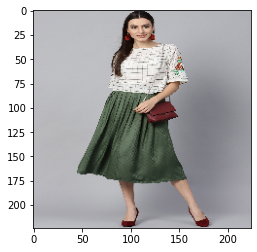

Printed


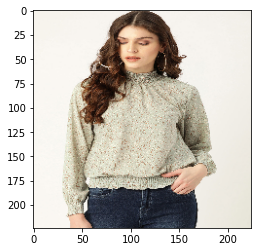

Printed


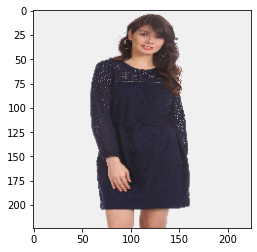

Printed


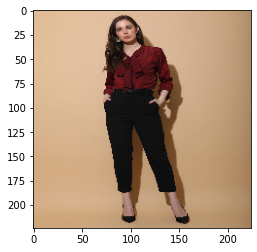

Printed


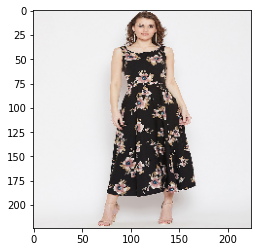

Animal Print


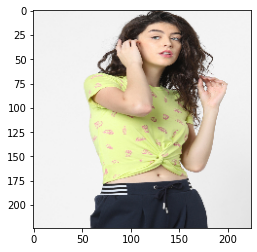

Printed


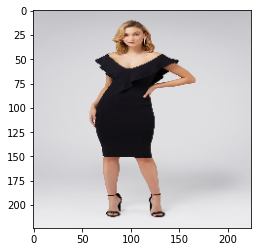

Printed


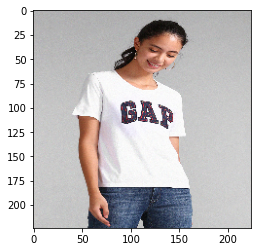

Printed


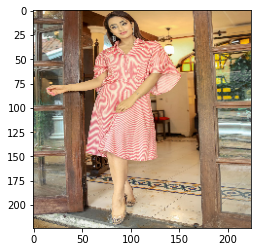

Printed


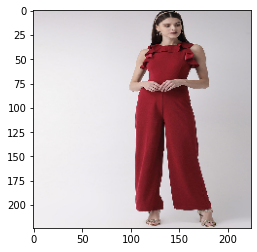

Printed


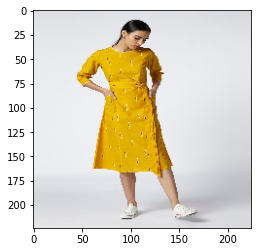

Printed


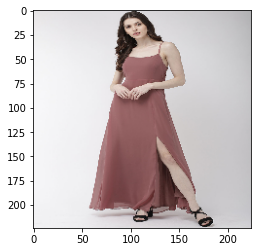

Printed


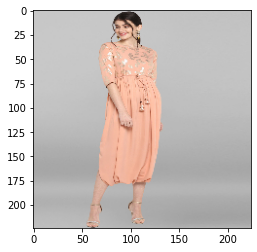

Printed


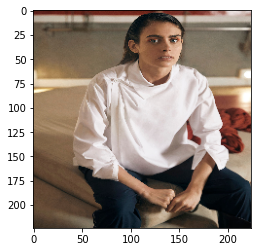

Ombre


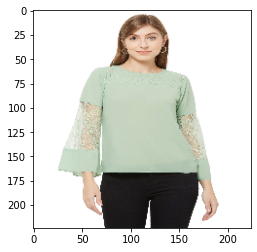

Printed


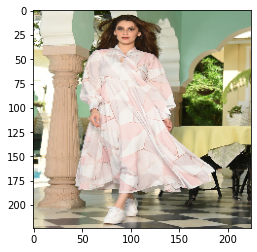

Printed


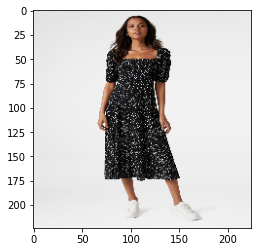

Animal Print


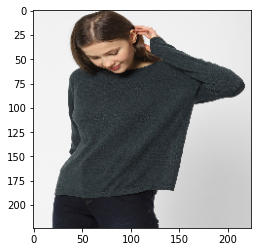

Printed


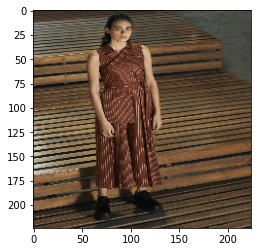

Ombre


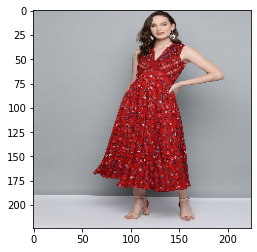

Ombre


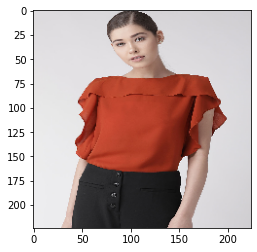

Printed


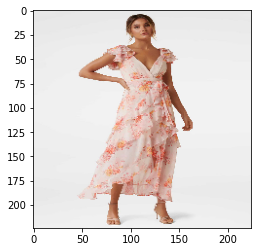

Printed


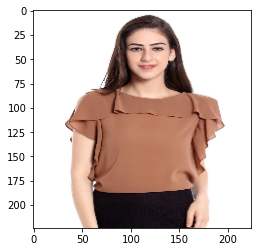

Printed


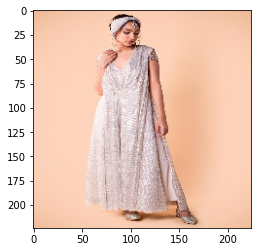

Printed


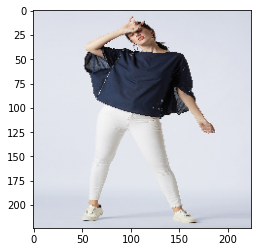

Printed


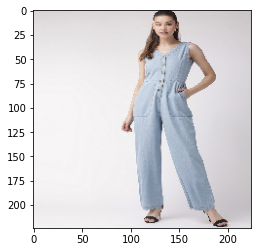

Printed


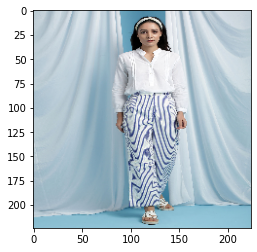

Geometric


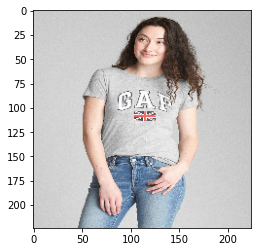

Ombre


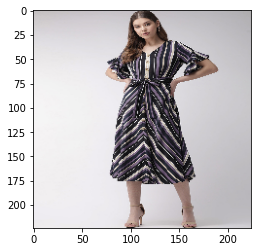

Animal Print


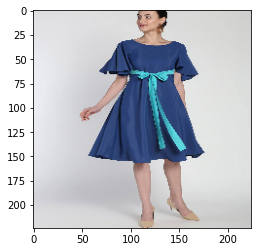

Printed


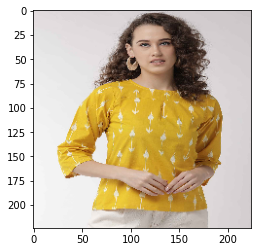

Printed


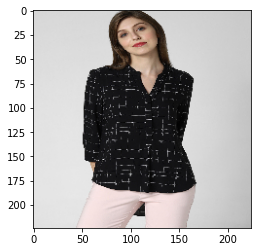

Printed


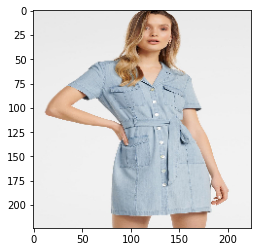

Printed


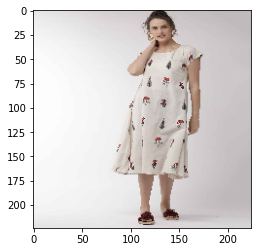

Ombre


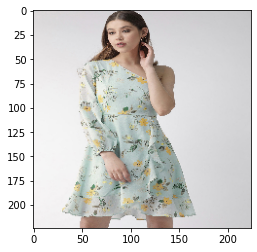

Printed


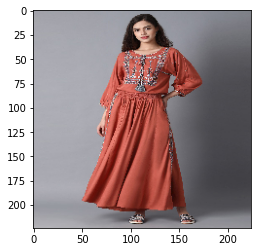

Printed


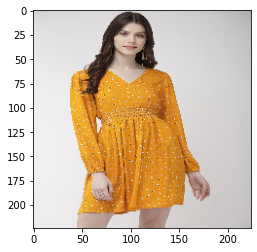

Ombre


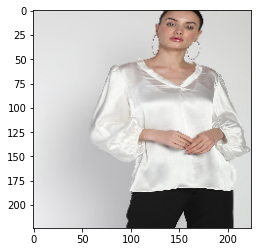

Printed


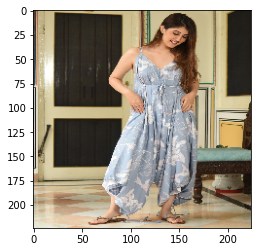

Printed


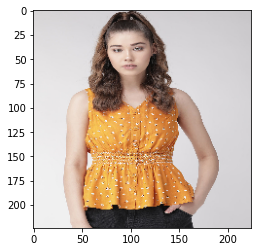

Animal Print


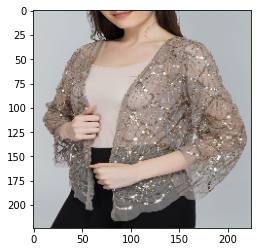

Printed


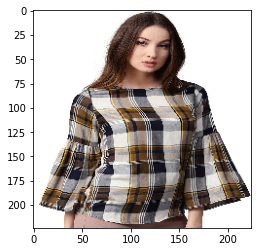

Printed


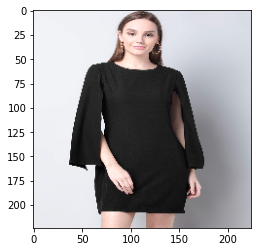

Printed


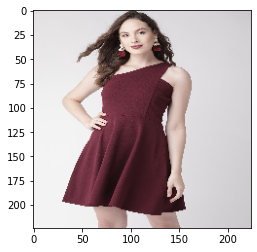

Printed


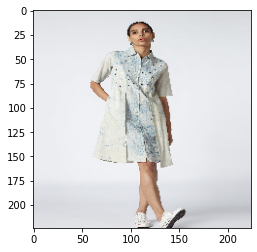

Ombre


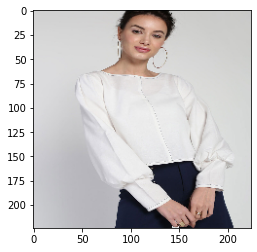

Printed


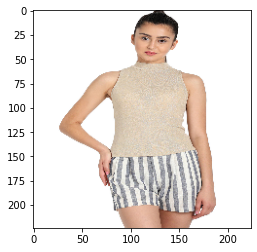

Printed


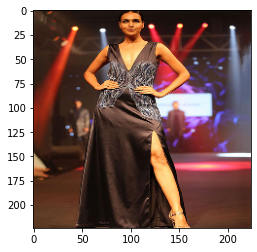

Ombre


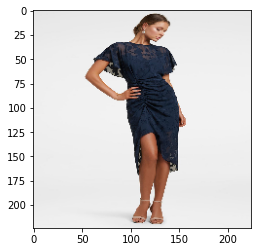

Printed


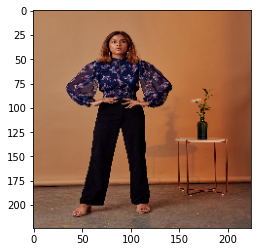

Printed


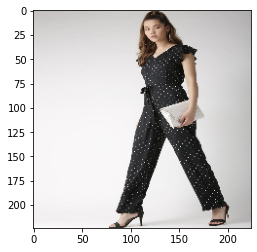

Printed


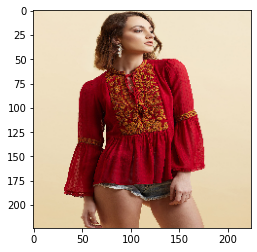

Printed


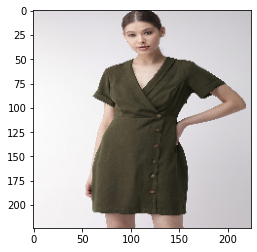

Printed


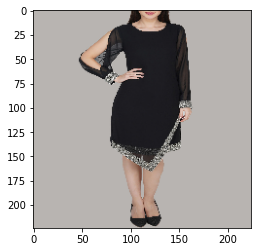

Printed


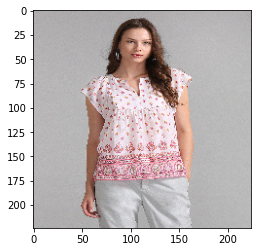

Ombre


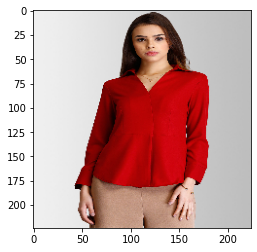

Printed


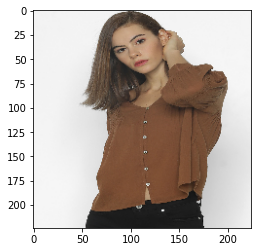

Printed


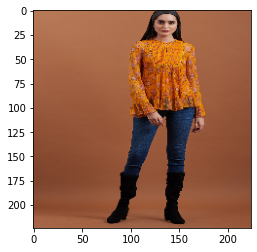

Ombre


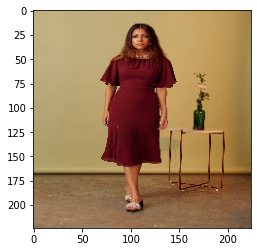

Printed


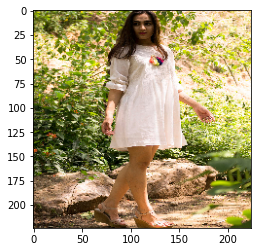

Printed


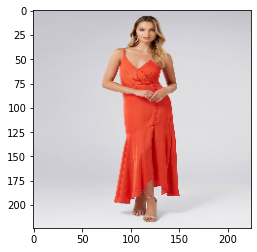

Printed


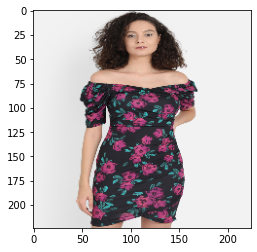

Printed


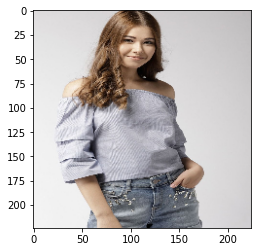

Printed


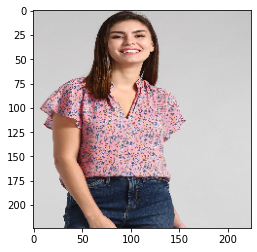

Ombre


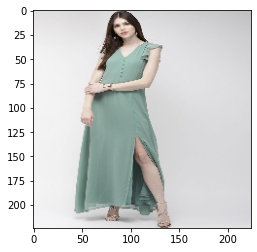

Printed


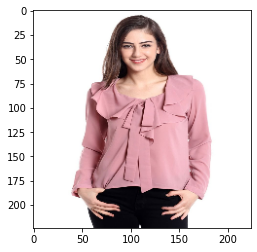

Printed


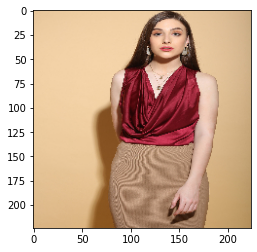

Printed


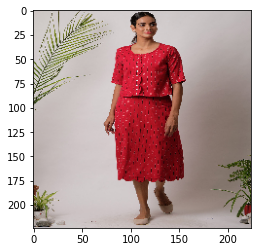

Ombre


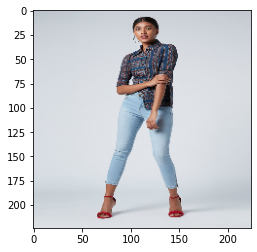

Printed


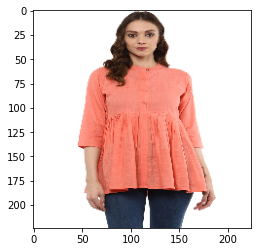

Printed


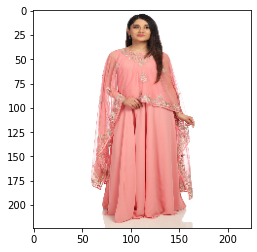

Ombre


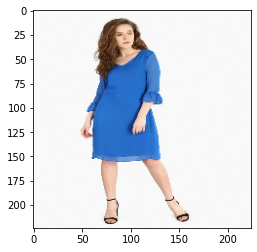

Printed


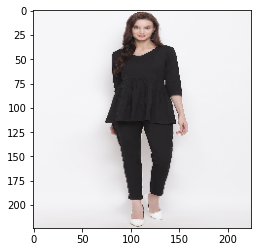

Printed


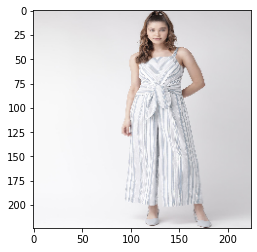

Printed


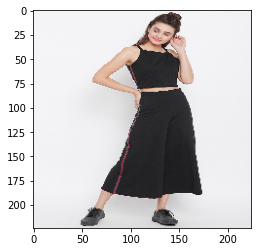

Printed


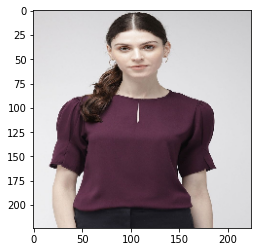

Printed


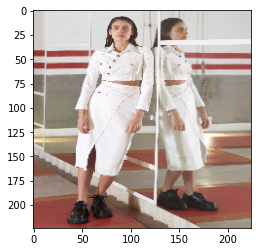

Printed


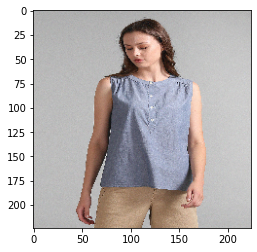

Printed


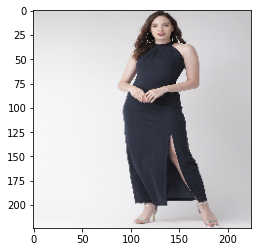

Printed


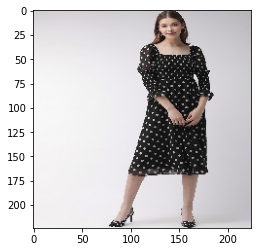

Printed


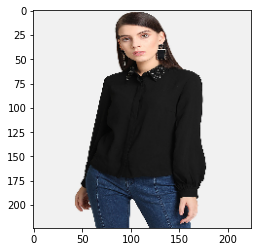

Printed


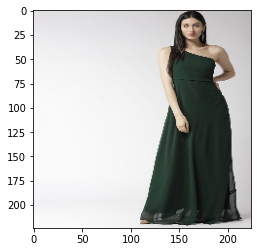

Printed


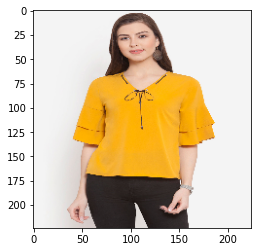

Animal Print


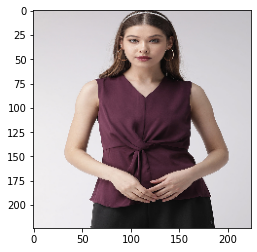

Printed


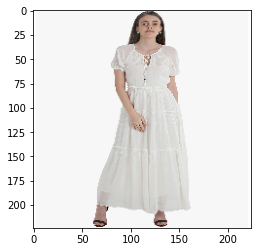

Printed


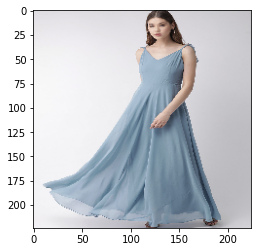

Printed


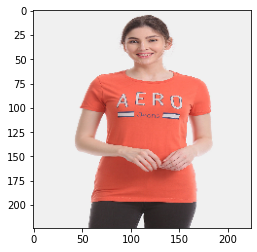

Ombre


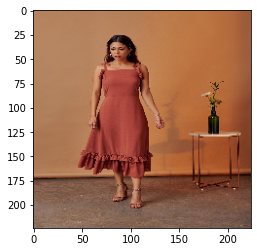

Ombre


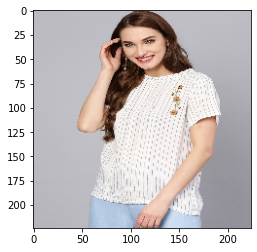

Printed


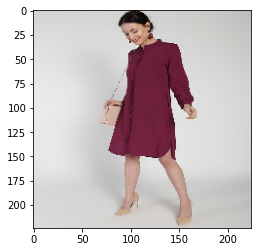

Printed


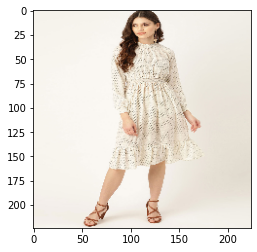

Printed


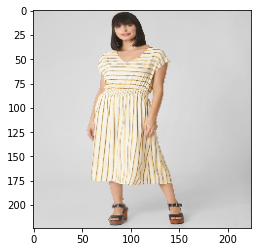

Animal Print


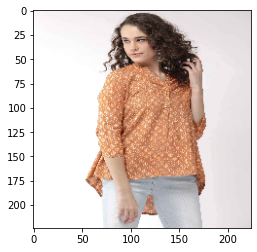

Printed


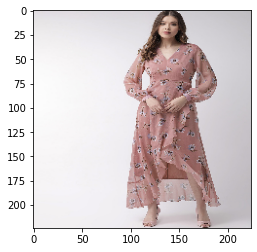

Printed


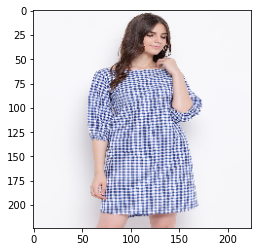

Geometric


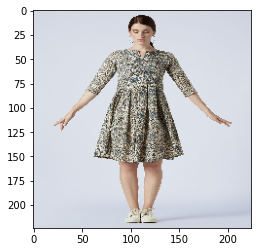

Animal Print


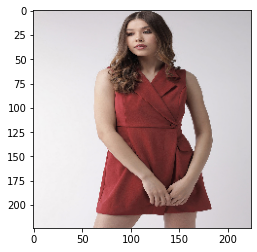

Printed


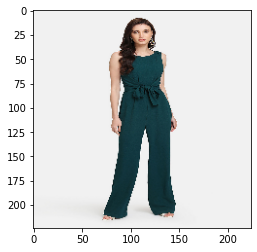

Printed


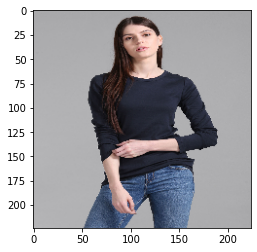

Printed


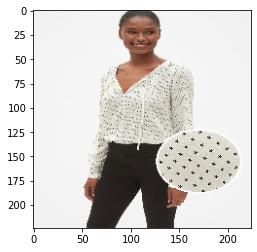

Ombre


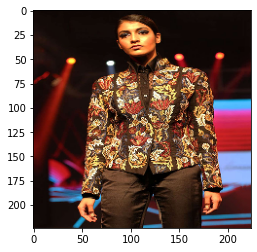

Ombre


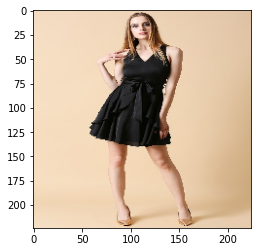

Printed


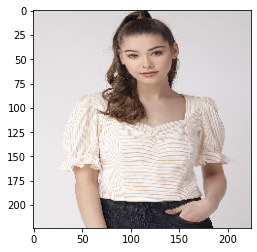

Printed


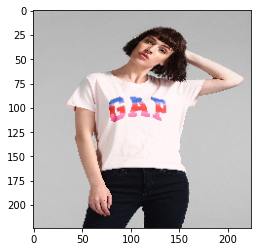

Printed


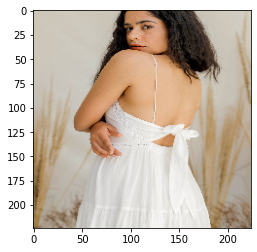

Printed


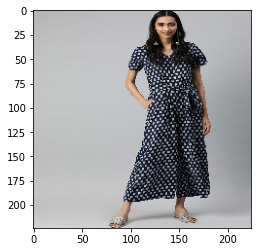

Ombre


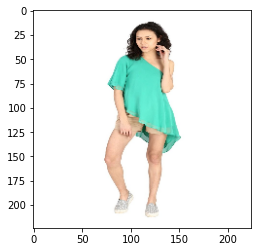

Printed


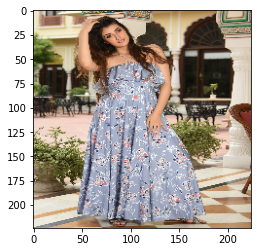

Printed


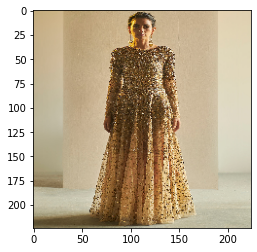

Animal Print


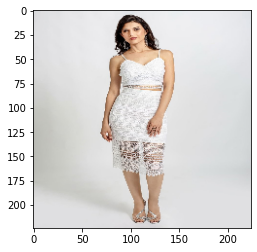

Printed


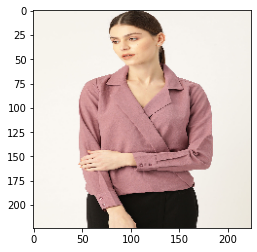

Printed


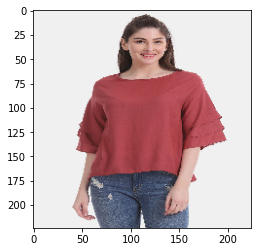

Printed


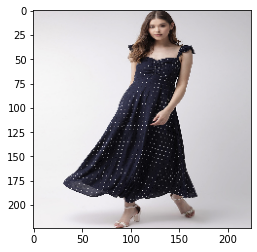

Printed


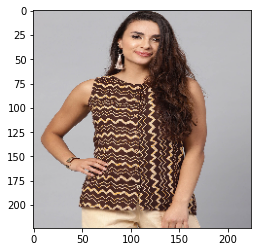

Animal Print


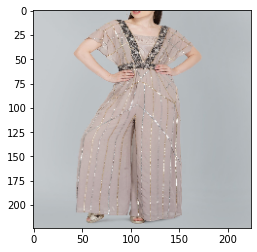

Printed


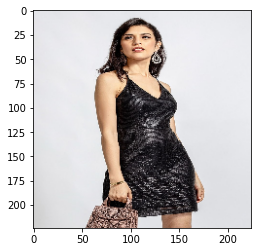

Printed


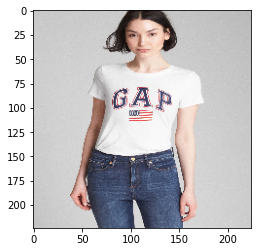

Printed


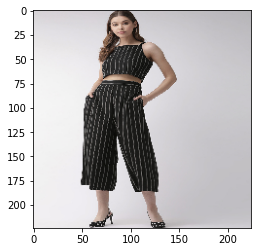

Geometric


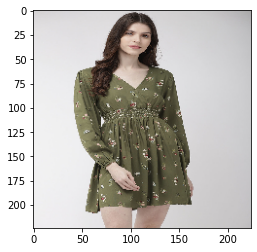

Animal Print


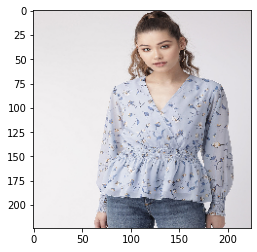

Printed


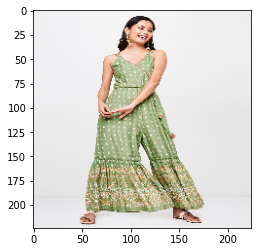

Printed


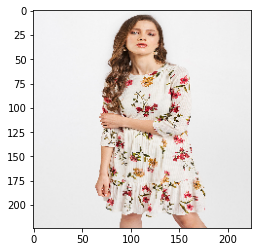

Animal Print


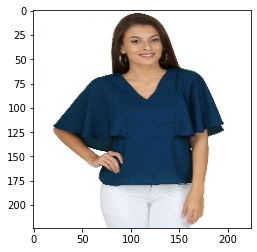

Printed


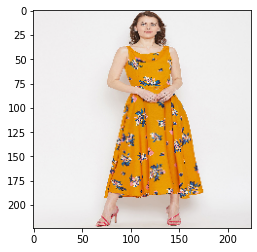

Ombre


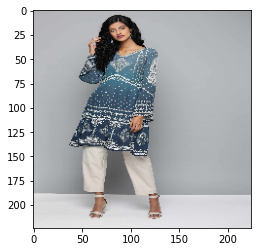

Animal Print


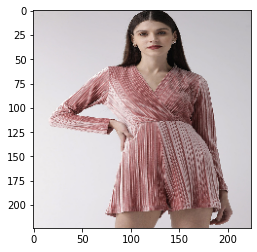

Ombre


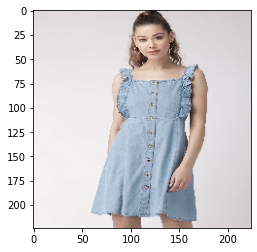

Printed


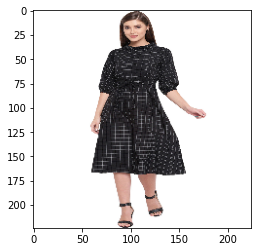

Printed


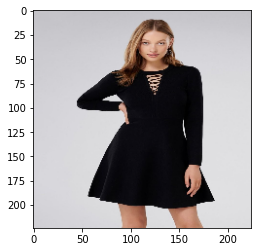

Printed


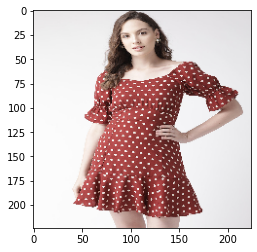

Ombre


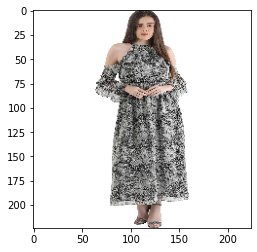

Geometric


In [87]:
#Pattern
from keras.models import load_model
model_p.compile(loss='categorical_crossentropy',
              optimizer='rmsprop',
              metrics=['accuracy'])

ind = 0
for i in (X_test_p['Image_Path']):
  img = cv2.imread(i)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 
  img = cv2.resize(img, (224,224))
  plt.imshow(img)
  plt.show()
  if(ind < 165):
    print(PT[classes_p[ind]])
    ind = ind + 1 

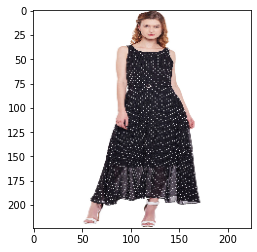

Khadi


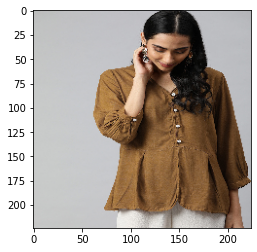

Khadi


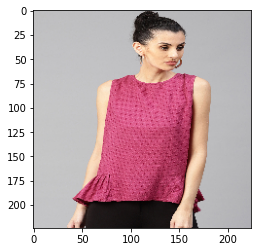

Modal


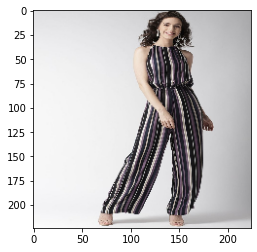

Modal


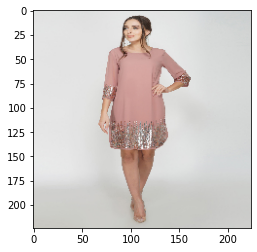

Modal


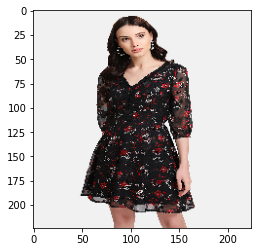

Khadi


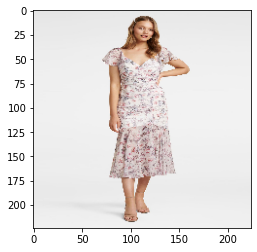

Modal


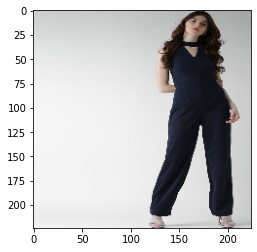

Modal


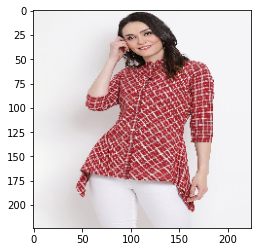

Modal


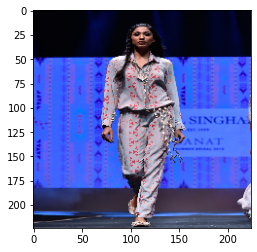

Modal


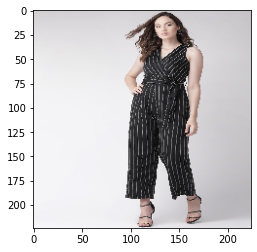

Khadi


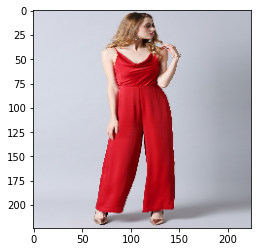

Khadi


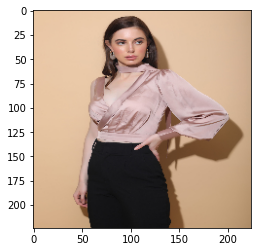

Modal


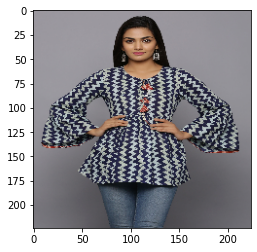

Modal


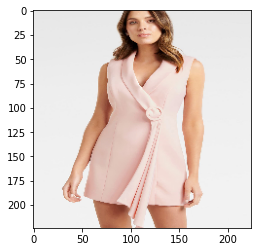

Modal


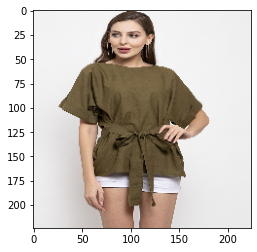

Khadi


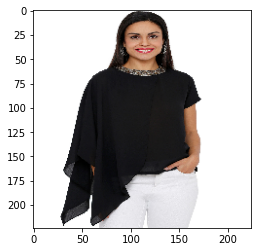

Khadi


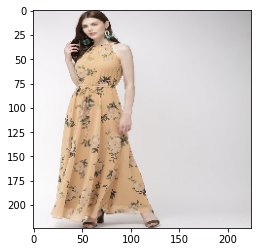

Modal


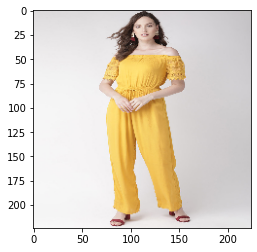

Modal


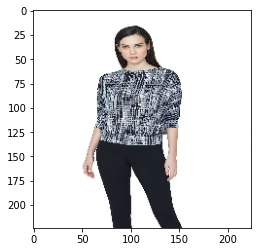

Khadi


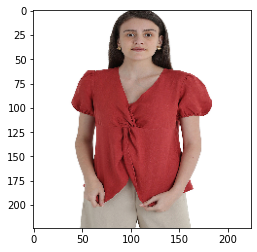

Khadi


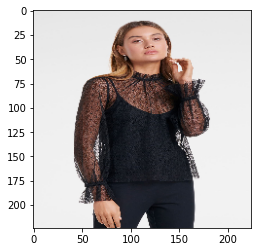

Khadi


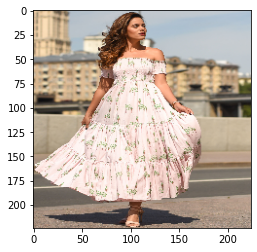

Modal


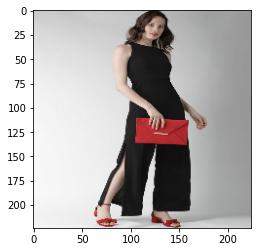

Khadi


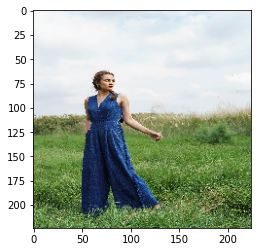

Modal


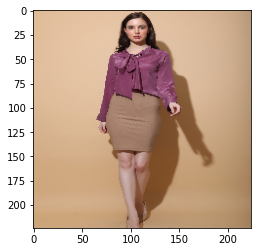

Modal


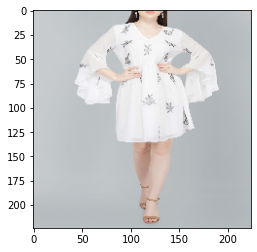

Modal


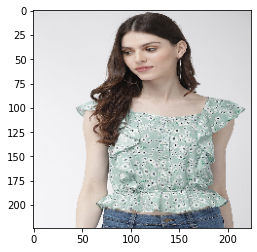

Modal


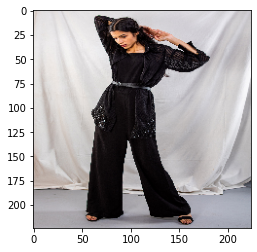

Khadi


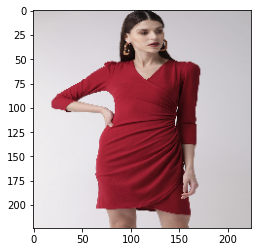

Khadi


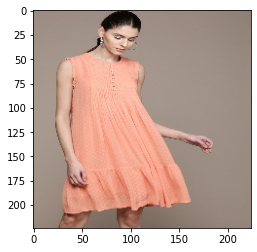

Modal


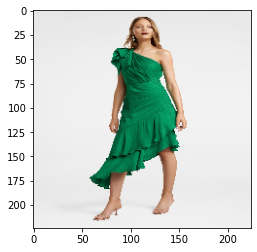

Khadi


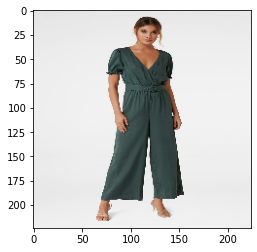

Khadi


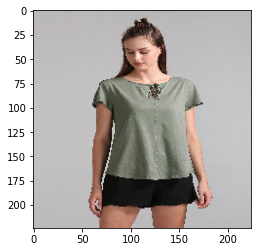

Modal


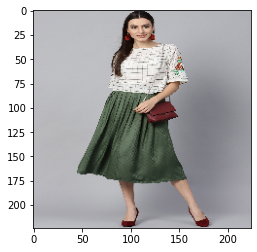

Modal


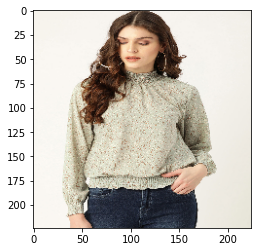

Modal


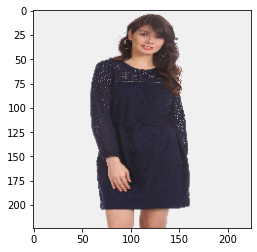

Khadi


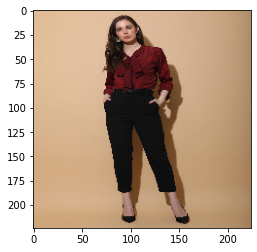

Khadi


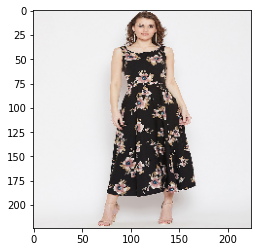

Khadi


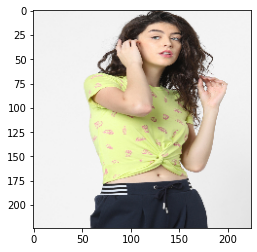

Modal


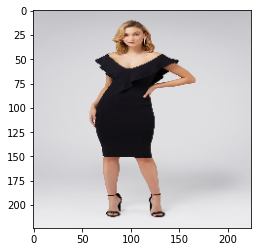

Khadi


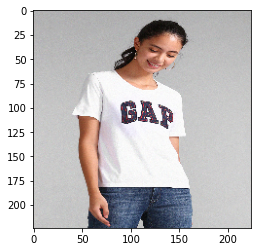

Modal


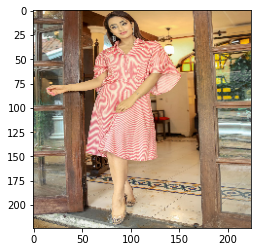

Modal


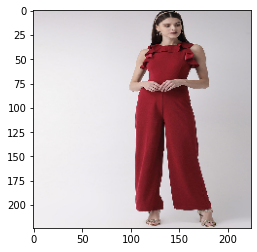

Modal


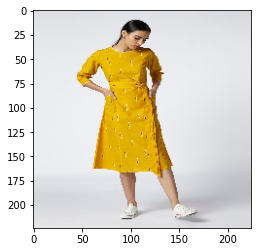

Modal


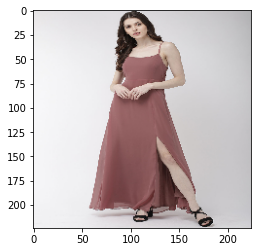

Khadi


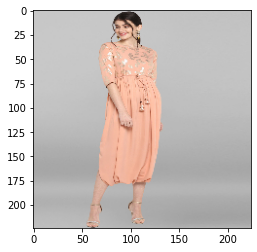

Modal


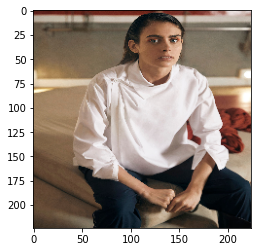

Modal


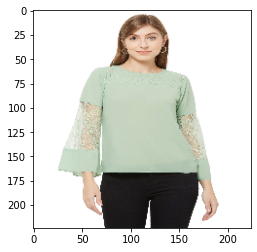

Modal


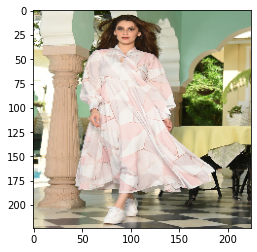

Modal


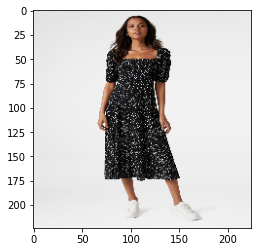

Khadi


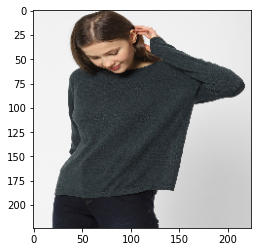

Khadi


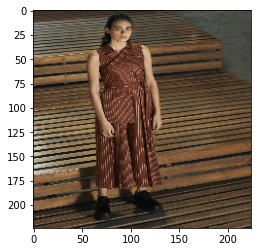

Modal


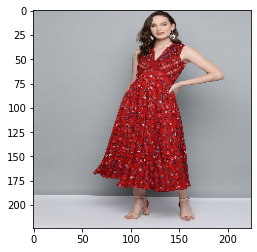

Khadi


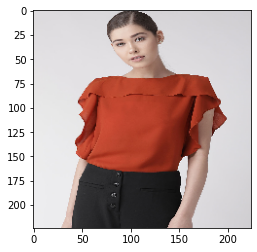

Khadi


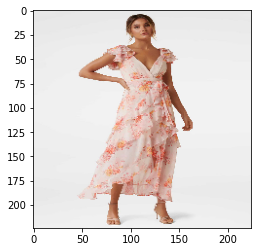

Modal


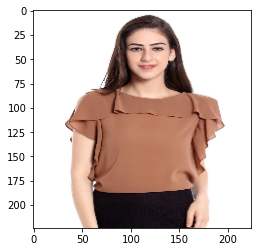

Modal


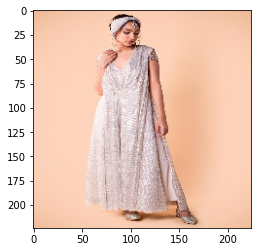

Modal


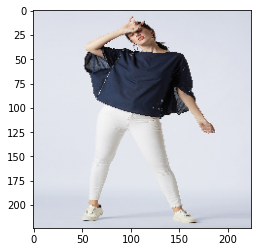

Modal


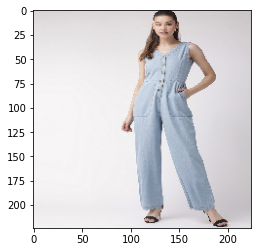

Modal


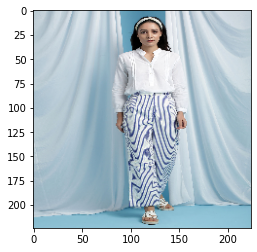

Modal


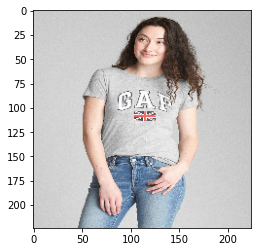

Modal


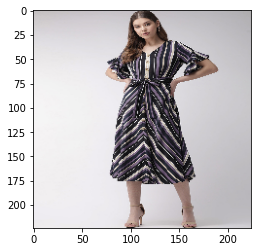

Khadi


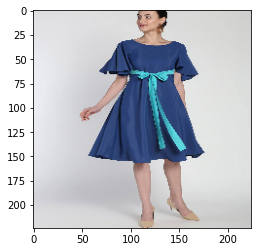

Khadi


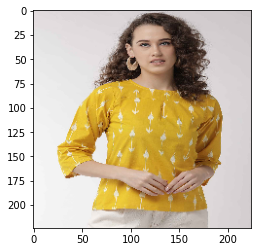

Modal


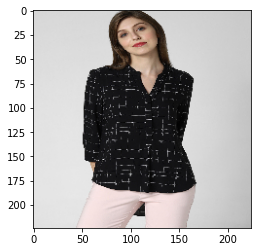

Khadi


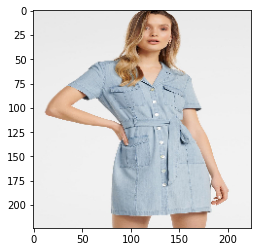

Modal


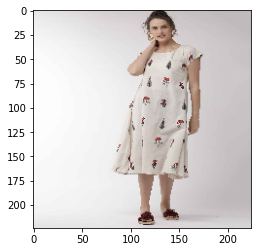

Modal


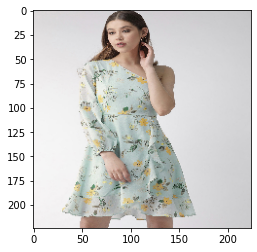

Modal


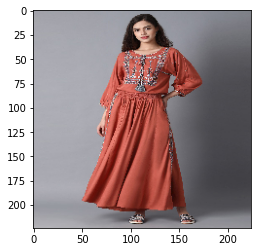

Modal


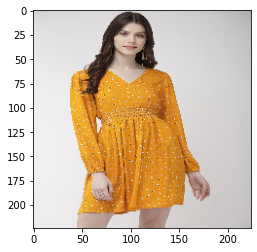

Modal


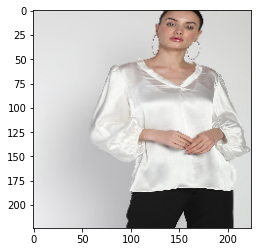

Modal


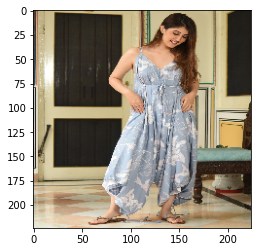

Modal


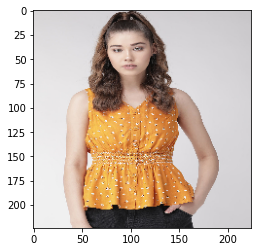

Modal


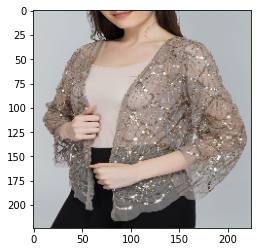

Modal


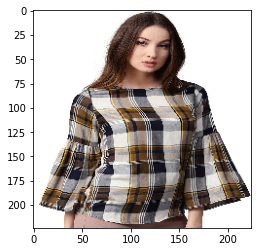

Modal


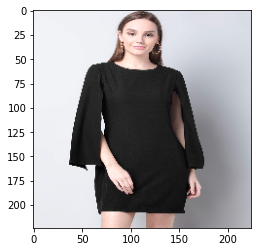

Khadi


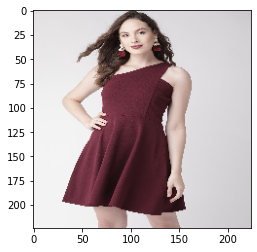

Khadi


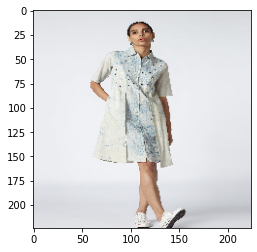

Modal


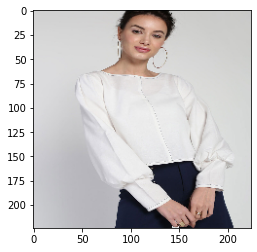

Modal


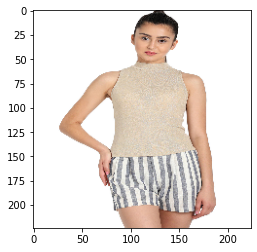

Modal


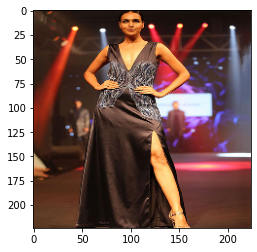

Modal


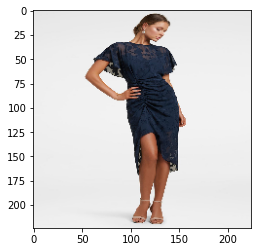

Khadi


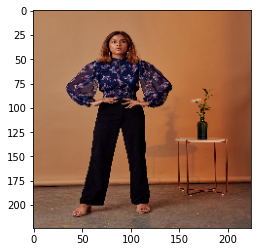

Khadi


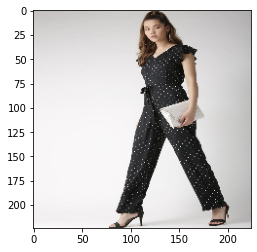

Modal


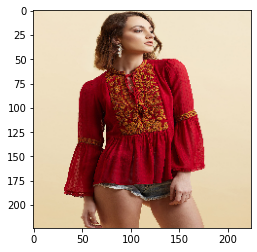

Khadi


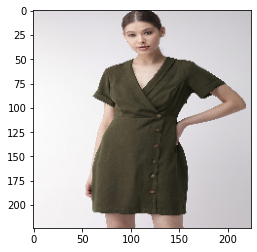

Khadi


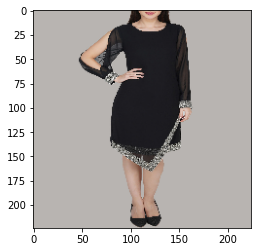

Khadi


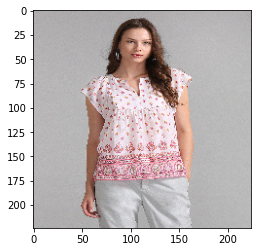

Modal


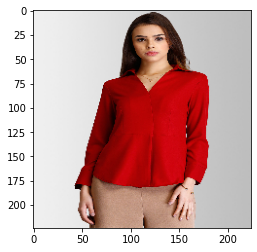

Khadi


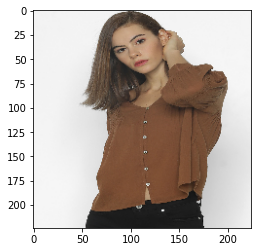

Khadi


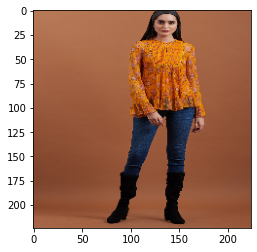

Modal


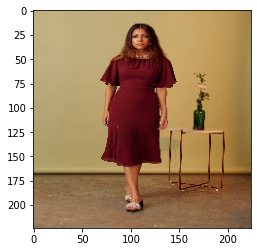

Khadi


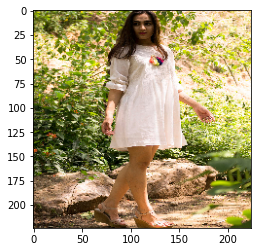

Modal


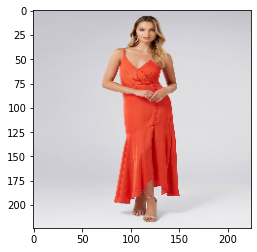

Modal


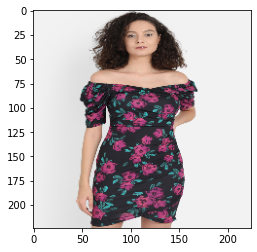

Khadi


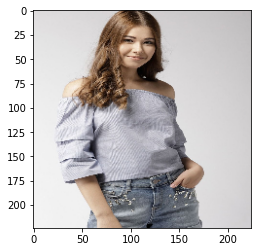

Modal


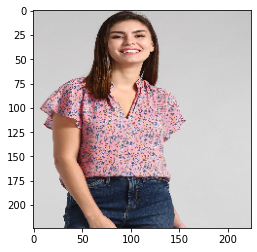

Modal


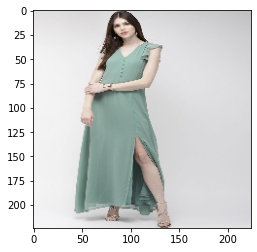

Modal


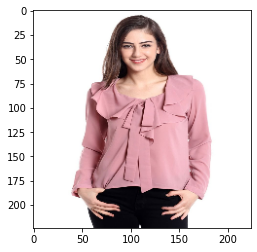

Modal


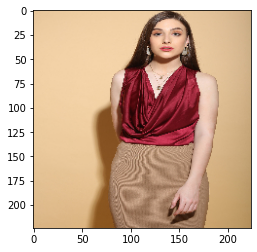

Modal


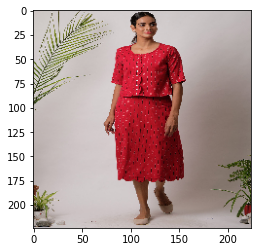

Khadi


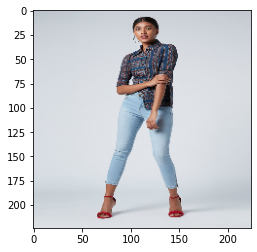

Modal


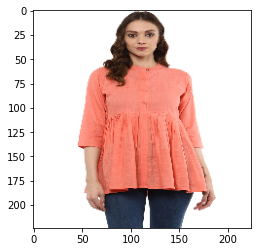

Modal


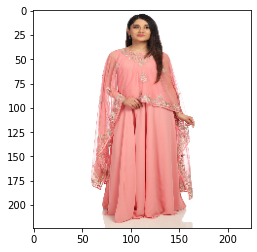

Modal


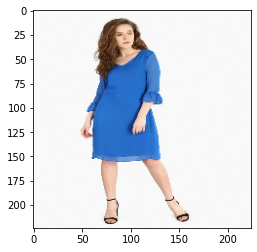

Modal


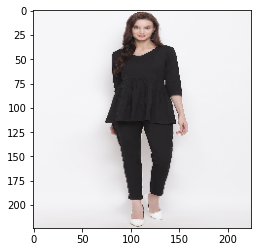

Khadi


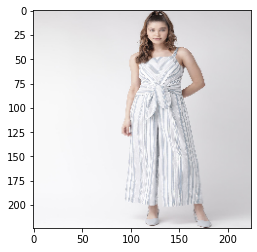

Modal


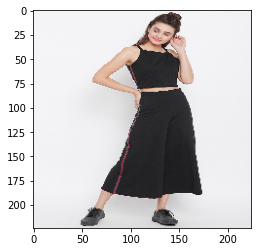

Khadi


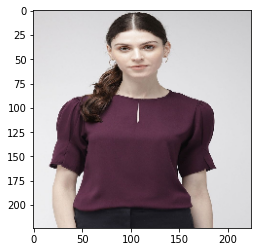

Modal


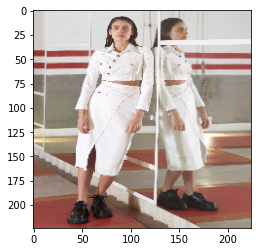

Modal


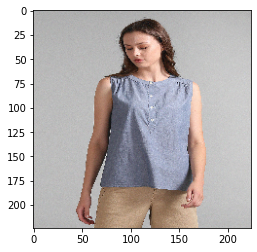

Modal


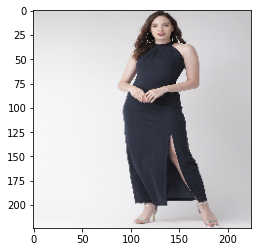

Khadi


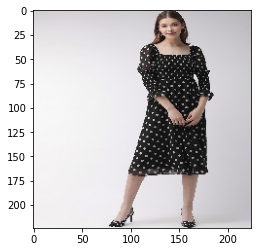

Modal


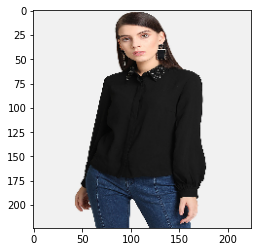

Khadi


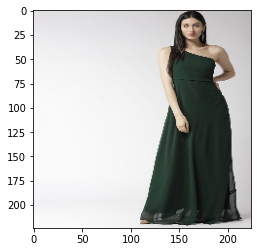

Modal


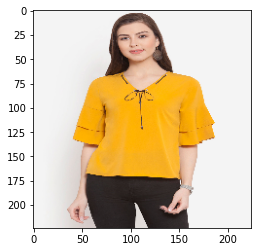

Modal


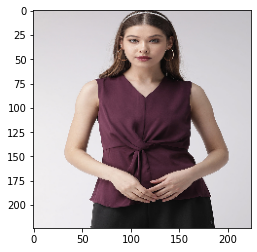

Khadi


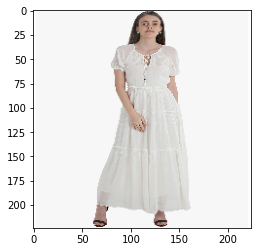

Modal


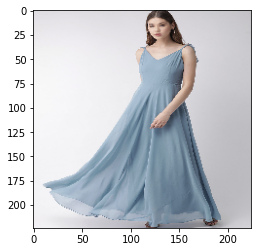

Modal


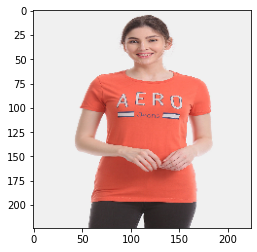

Modal


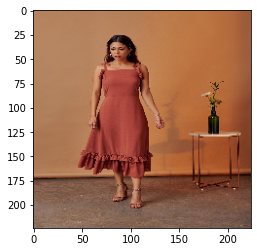

Modal


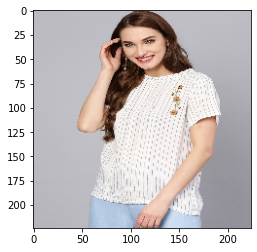

Modal


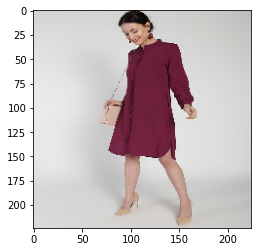

Khadi


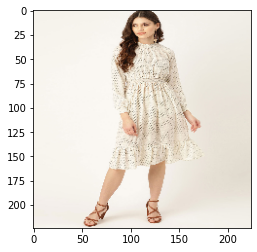

Modal


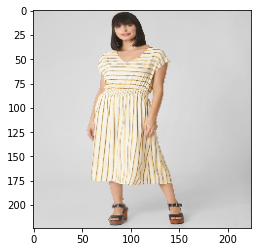

Modal


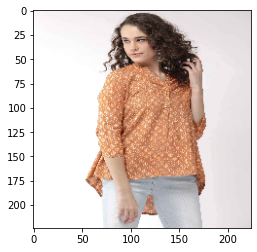

Modal


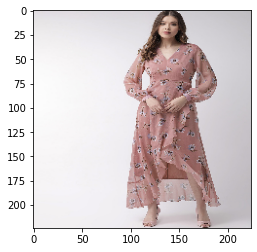

Modal


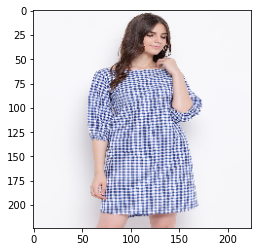

Modal


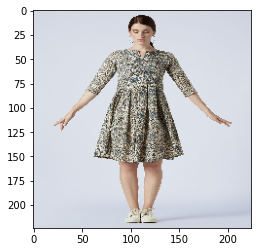

Modal


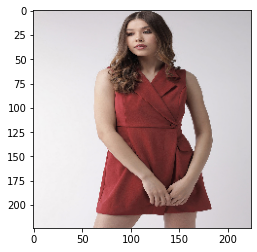

Khadi


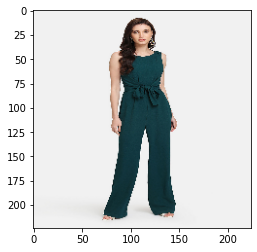

Khadi


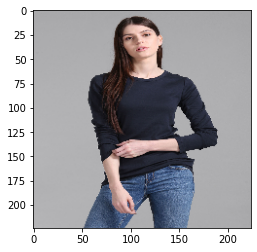

Khadi


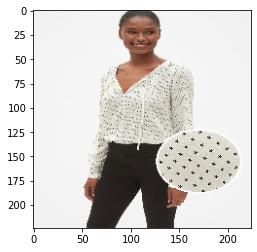

Modal


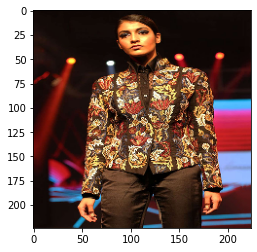

Modal


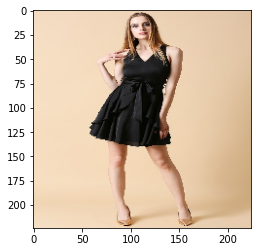

Khadi


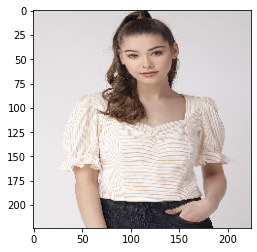

Modal


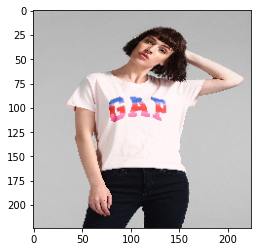

Modal


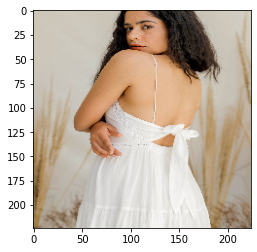

Modal


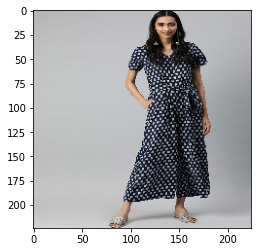

Modal


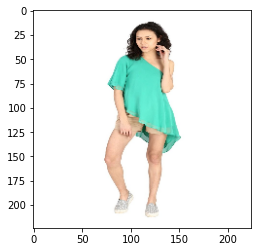

Modal


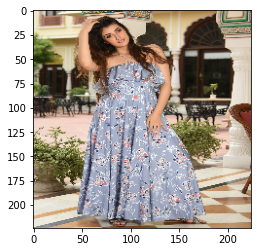

Modal


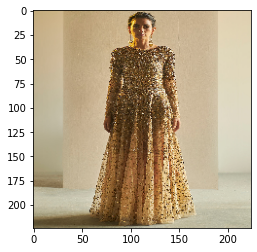

Modal


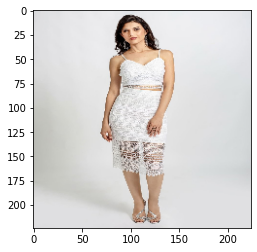

Modal


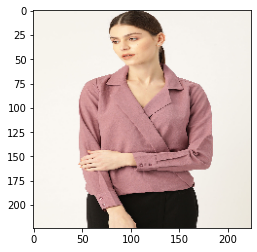

Modal


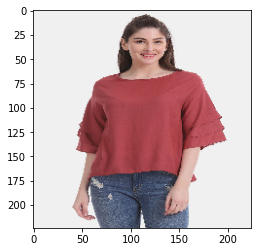

Modal


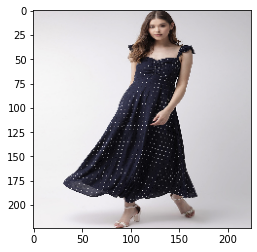

Khadi


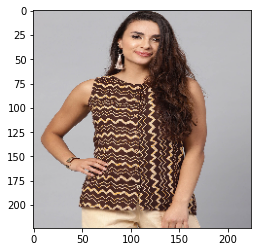

Modal


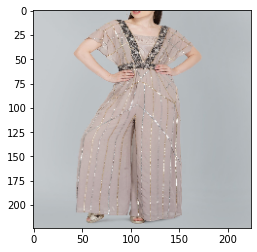

Modal


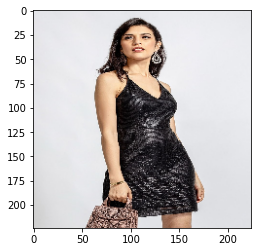

Khadi


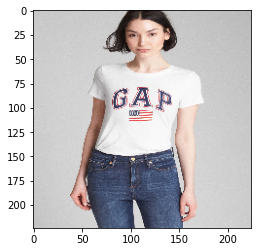

Modal


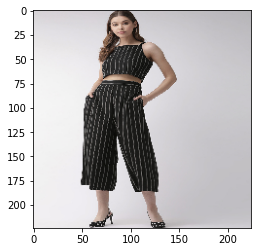

Modal


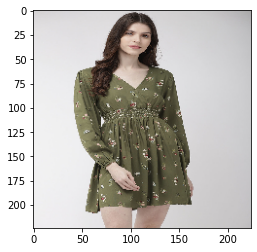

Khadi


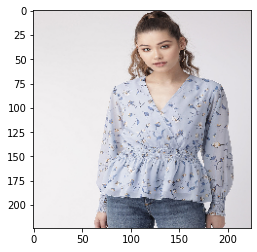

Modal


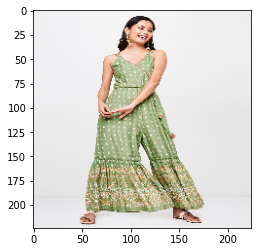

Modal


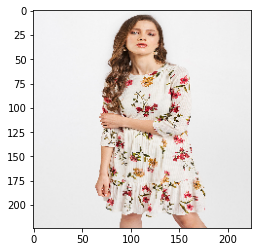

Modal


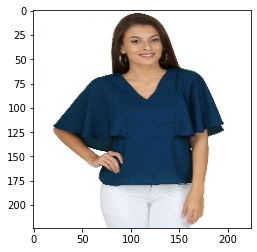

Khadi


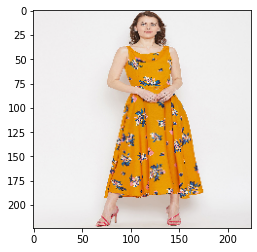

Modal


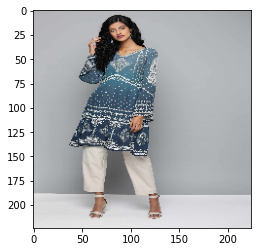

Modal


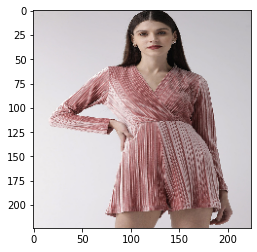

Modal


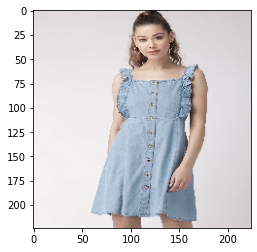

Modal


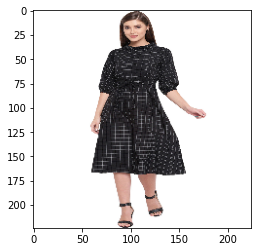

Khadi


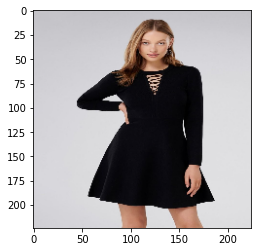

Khadi


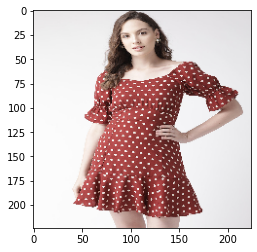

Modal


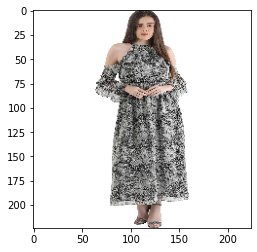

Modal


In [88]:
#Material
from keras.models import load_model
model_m.compile(loss='categorical_crossentropy',
              optimizer='rmsprop',
              metrics=['accuracy'])

ind = 0
for i in (X_test_m['Image_Path']):
  img = cv2.imread(i)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 
  img = cv2.resize(img, (224,224))
  plt.imshow(img)
  plt.show()
  if(ind < 165):
    print(MT[classes_m[ind]])
    ind = ind + 1 